mc.cores = parallel::detectCores()
#rstan_options(auto_write = TRUE)

library(rethinking)

In [2]:
num_weeks <- 1e5
positions <- rep(0,num_weeks)
current <- 10
for ( i in 1:num_weeks ) {
# record current position
positions[i] <- current
# flip coin to generate proposal
proposal <- current + sample( c(-1,1) , size=1 )
# now make sure he loops around the archipelago
if ( proposal < 1 ) proposal <- 10
if ( proposal > 10 ) proposal <- 1
# move?
prob_move <- proposal/current
current <- ifelse( runif(1) < prob_move , proposal , current )
}

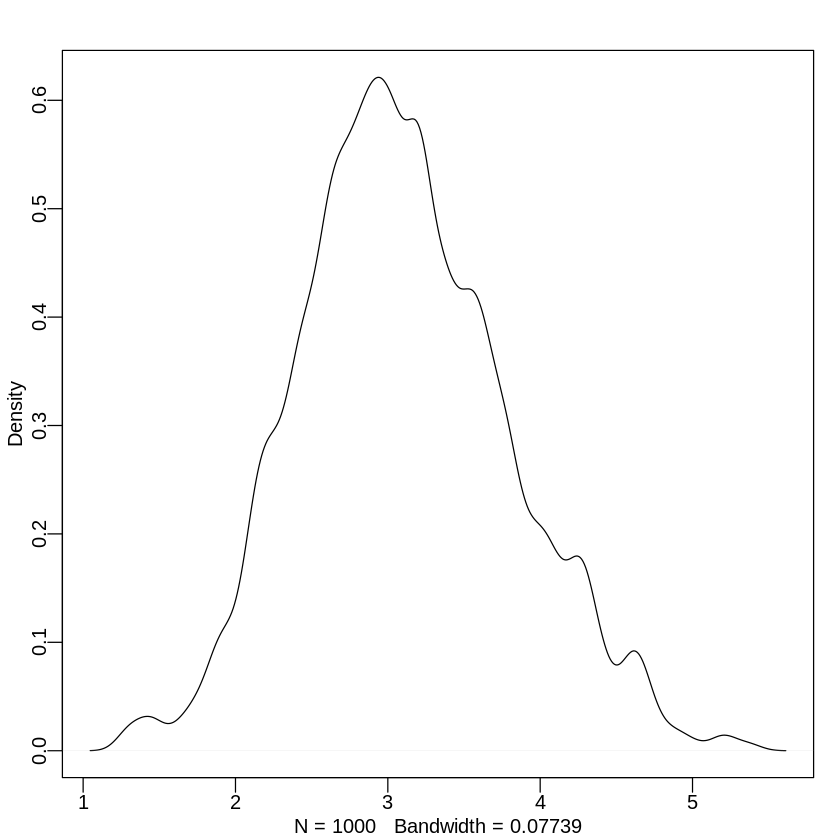

In [3]:
D <- 10
T <- 1e3
Y <- rmvnorm(T,rep(0,D),diag(D))
rad_dist <- function( Y ) sqrt( sum(Y^2) )
Rd <- sapply( 1:T , function(i) rad_dist( Y[i,] ) )
dens( Rd )

In [4]:
# U needs to return neg-log-probability
myU4 <- function( q , a=0 , b=1 , k=0 , d=1 ) {
muy <- q[1]
mux <- q[2]
U <- sum( dnorm(y,muy,1,log=TRUE) ) + sum( dnorm(x,mux,1,log=TRUE) ) +
dnorm(muy,a,b,log=TRUE) + dnorm(mux,k,d,log=TRUE)
return( -U )
}

In [5]:
# gradient function
# need vector of partial derivatives of U with respect to vector q
myU_grad4 <- function( q , a=0 , b=1 , k=0 , d=1 ) {
muy <- q[1]
mux <- q[2]
G1 <- sum( y - muy ) + (a - muy)/b^2 #dU/dmuy
G2 <- sum( x - mux ) + (k - mux)/d^2 #dU/dmuy
return( c( -G1 , -G2 ) ) # negative bc energy is neg-log-prob
}
# test data
set.seed(7)
y <- rnorm(50)
x <- rnorm(50)
x <- as.numeric(scale(x))
y <- as.numeric(scale(y))

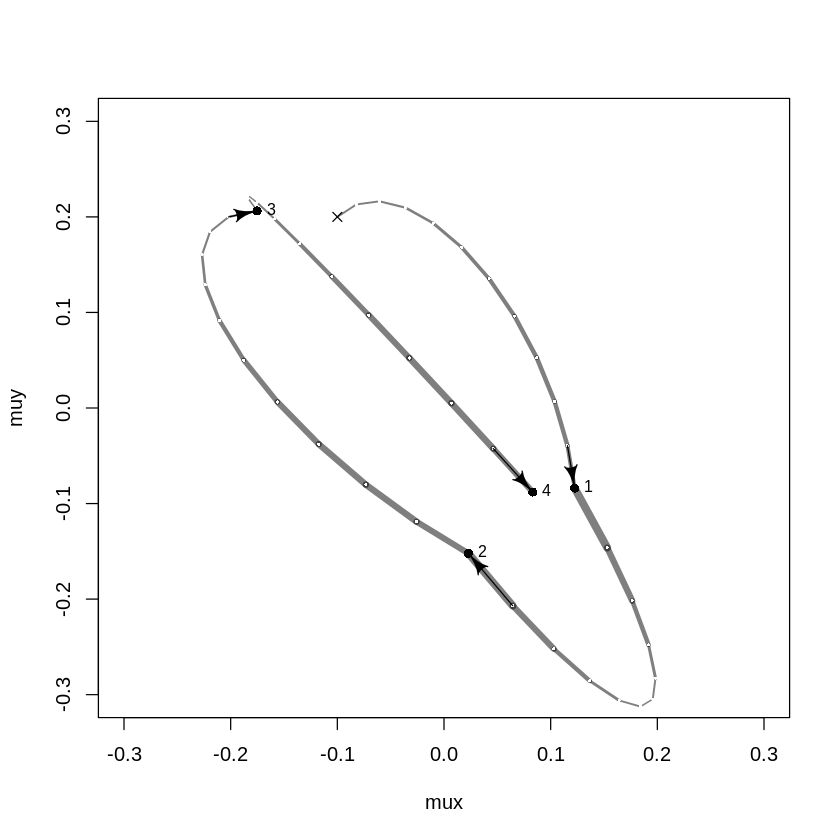

In [6]:
#install.packages("shape")
library(shape) # for fancy arrows
Q <- list()
Q$q <- c(-0.1,0.2)
pr <- 0.3
plot( NULL , ylab="muy" , xlab="mux" , xlim=c(-pr,pr) , ylim=c(-pr,pr) )
step <- 0.03
L <- 11 # 0.03/28 for U-turns --- 11 for working example
n_samples <- 4
path_col <- col.alpha("black",0.5)
points( Q$q[1] , Q$q[2] , pch=4 , col="black" )
for ( i in 1:n_samples ) {
Q <- HMC2( myU4 , myU_grad4 , step , L , Q$q )
if ( n_samples < 10 ) {
for ( j in 1:L ) {
K0 <- sum(Q$ptraj[j,]^2)/2 # kinetic energy
lines( Q$traj[j:(j+1),1] , Q$traj[j:(j+1),2] , col=path_col , lwd=1+2*K0 )
}
points( Q$traj[1:L+1,] , pch=16 , col="white" , cex=0.35 )
Arrows( Q$traj[L,1] , Q$traj[L,2] , Q$traj[L+1,1] , Q$traj[L+1,2] ,
arr.length=0.35 , arr.adj = 0.7 )
text( Q$traj[L+1,1] , Q$traj[L+1,2] , i , cex=0.8 , pos=4 , offset=0.4 )
}
points( Q$traj[L+1,1] , Q$traj[L+1,2] , pch=ifelse( Q$accept==1 , 16 , 1 ) ,
col=ifelse( abs(Q$dH)>0.1 , "red" , "black" ) )
}

In [7]:
HMC2 <- function (U, grad_U, epsilon, L, current_q) {
    q = current_q
    p = rnorm(length(q),0,1) # random flick - p is momentum.
    current_p = p
    # Make a half step for momentum at the beginning
    p = p - epsilon * grad_U(q) / 2
    # initialize bookkeeping - saves trajectory
    qtraj <- matrix(NA,nrow=L+1,ncol=length(q))
    ptraj <- qtraj
    qtraj[1,] <- current_q
    ptraj[1,] <- p
    # Alternate full steps for position and momentum
    for ( i in 1:L ) {
        q = q + epsilon * p # Full step for the position
        # Make a full step for the momentum, except at end of trajectory
        if ( i!=L ) {
            p = p - epsilon * grad_U(q)
            ptraj[i+1,] <- p
        }
        qtraj[i+1,] <- q
    }
    # Make a half step for momentum at the end
    p = p - epsilon * grad_U(q) / 2
    ptraj[L+1,] <- p
    # Negate momentum at end of trajectory to make the proposal symmetric
    p = -p
    # Evaluate potential and kinetic energies at start and end of trajectory
    current_U = U(current_q)
    current_K = sum(current_p^2) / 2
    proposed_U = U(q)
    proposed_K = sum(p^2) / 2
    # Accept or reject the state at end of trajectory, returning either
    # the position at the end of the trajectory or the initial position
    accept <- 0
    if (runif(1) < exp(current_U-proposed_U+current_K-proposed_K)) {
        new_q <- q # accept
        accept <- 1
    } else new_q <- current_q # reject
    return(list( q=new_q, traj=qtraj, ptraj=ptraj, accept=accept ))
}

In [8]:
library(rethinking)
data(rugged)
d <- rugged

d$log_gdp <- log(d$rgdppc_2000)
dd <- d[ complete.cases(d$rgdppc_2000) , ]
dd$log_gdp_std <- dd$log_gdp / mean(dd$log_gdp)
dd$rugged_std <- dd$rugged / max(dd$rugged)
dd$cid <- ifelse( dd$cont_africa==1 , 1 , 2 )

In [9]:
m8.5 <- quap(
            alist(
                log_gdp_std ~ dnorm( mu, sigma),
                mu <- a[cid] + b[cid]*(rugged_std - 0.215),
                a[cid] ~ dnorm( 1 , 0.1),
                b[cid] ~ dnorm( 0 , 0.3),
                sigma ~ dexp( 1 )
            ) ,
            data=dd )
precis( m8.5 , depth=2 )

,mean,sd,5.5%,94.5%
,<dbl>,<dbl>,<dbl>,<dbl>
a[1],0.8865640,0.015674552,0.86151302,0.91161495
a[2],1.0505666,0.009935872,1.03468714,1.06644602
b[1],0.1324981,0.074199237,0.01391344,0.25108286
b[2],-0.1426057,0.054745410,-0.23009945,-0.05511197
sigma,0.1094859,0.005934188,0.10000194,0.11896990


In [10]:
dat_slim <- data.frame(
log_gdp_std = dd$log_gdp_std,
rugged_std = dd$rugged_std,
cid = as.integer( dd$cid )
)
str(dat_slim)

'data.frame':	170 obs. of  3 variables:
 $ log_gdp_std: num  0.88 0.965 1.166 1.104 0.915 ...
 $ rugged_std : num  0.138 0.553 0.124 0.125 0.433 ...
 $ cid        : int  1 2 2 2 2 2 2 2 2 1 ...


In [11]:
m9.1 <- ulam(
            alist(
                log_gdp_std ~ dnorm( mu , sigma ) ,
                mu <- a[cid] + b[cid]*( rugged_std - 0.215 ) ,
                a[cid] ~ dnorm( 1 , 0.1 ) ,
                b[cid] ~ dnorm( 0 , 0.3 ) ,
                sigma ~ dexp( 1 )
                ) ,
            data=dat_slim , chains=4 , cores=4 , iter=1000 )

In [12]:
precis( m9.1 , depth=2 )

,mean,sd,5.5%,94.5%,n_eff,Rhat
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
a[1],0.8866475,0.015883392,0.861417051,0.91187109,3126.912,0.9983801
a[2],1.0507915,0.010338273,1.033743868,1.06746513,2944.715,0.9990415
b[1],0.1329219,0.076141837,0.009281116,0.25597731,2348.455,0.9981437
b[2],-0.1437071,0.055494942,-0.233569134,-0.05328029,2195.111,0.9994022
sigma,0.1116656,0.006180095,0.102578133,0.12190302,2462.777,0.9992362


In [13]:
show( m9.1 )

Hamiltonian Monte Carlo approximation
2000 samples from 4 chains

Sampling durations (seconds):
        warmup sample total
chain:1   0.15   0.10  0.26
chain:2   0.15   0.10  0.25
chain:3   0.17   0.09  0.26
chain:4   0.16   0.11  0.27

Formula:
log_gdp_std ~ dnorm(mu, sigma)
mu <- a[cid] + b[cid] * (rugged_std - 0.215)
a[cid] ~ dnorm(1, 0.1)
b[cid] ~ dnorm(0, 0.3)
sigma ~ dexp(1)


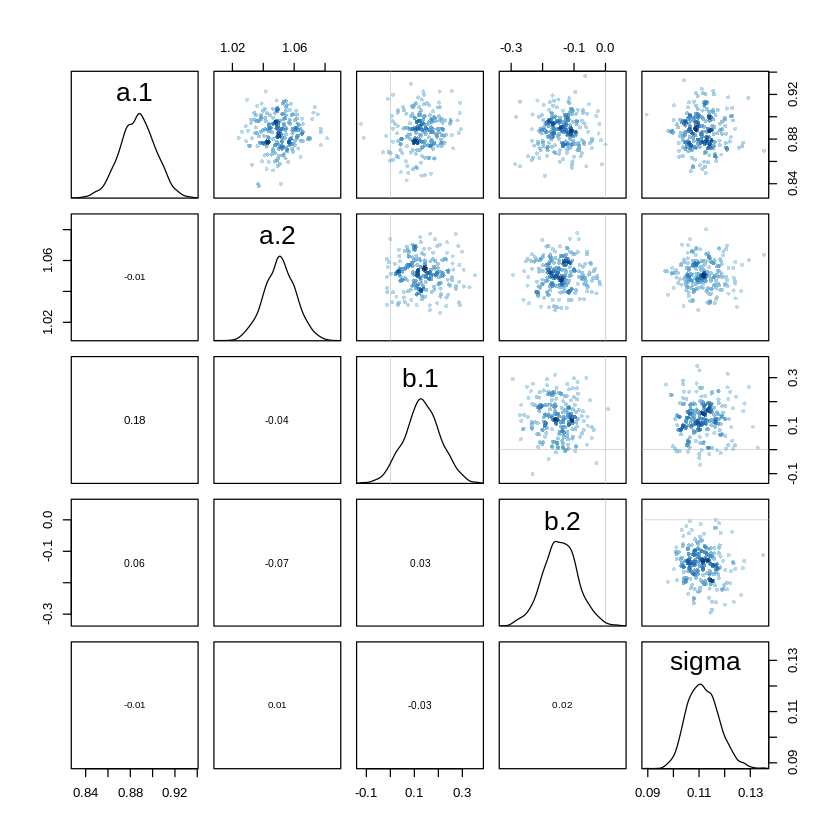

In [14]:
pairs(m9.1)

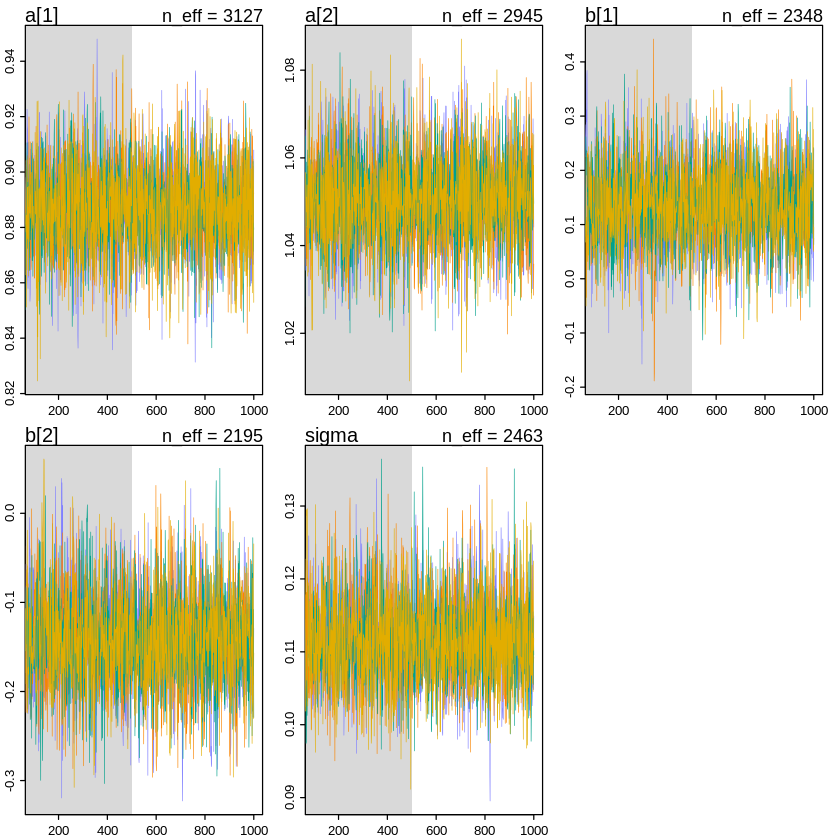

In [15]:
traceplot( m9.1,
         #chains=1
         )

In [16]:
stancode(m9.1)

data{
    vector[170] log_gdp_std;
    vector[170] rugged_std;
    int cid[170];
}
parameters{
    vector[2] a;
    vector[2] b;
    real<lower=0> sigma;
}
model{
    vector[170] mu;
    sigma ~ exponential( 1 );
    b ~ normal( 0 , 0.3 );
    a ~ normal( 1 , 0.1 );
    for ( i in 1:170 ) {
        mu[i] = a[cid[i]] + b[cid[i]] * (rugged_std[i] - 0.215);
    }
    log_gdp_std ~ normal( mu , sigma );
}



In [17]:
y <- c(-1,1)
#y <- (2*rbinom(size=1, n=1e4, prob=0.5))-1     #This extra data leads to convergent sensible answers.  Or you can tighten the priors, as in m9.3 below.

set.seed(11)

m9.2 <- ulam(
            alist(
                y ~ dnorm( mu , sigma ) ,
                mu <- alpha ,
                alpha ~ dnorm( 0 , 1000 ) ,
                sigma ~ dexp( 0.0001 )
                ) ,
            data=list(y=y) , chains=4, cores=4
           # , control=list(adapt_delta=0.999, max_treedepth=20)

)

Cautionary note:
Variable y contains only integers but is not type 'integer'. If you intend it as an index variable, you should as.integer() it before passing to ulam.
Warning message:
“There were 87 divergent transitions after warmup. Increasing adapt_delta above 0.95 may help. See
http://mc-stan.org/misc/warnings.html#divergent-transitions-after-warmup”Warning message:
“Examine the pairs() plot to diagnose sampling problems
”

In [18]:
precis( m9.2 )

,mean,sd,5.5%,94.5%,n_eff,Rhat
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
alpha,-21.22657,398.5689,-662.81775,527.0673,150.6582,1.012873
sigma,705.70931,1502.7525,12.02884,3068.2278,184.7924,1.021386


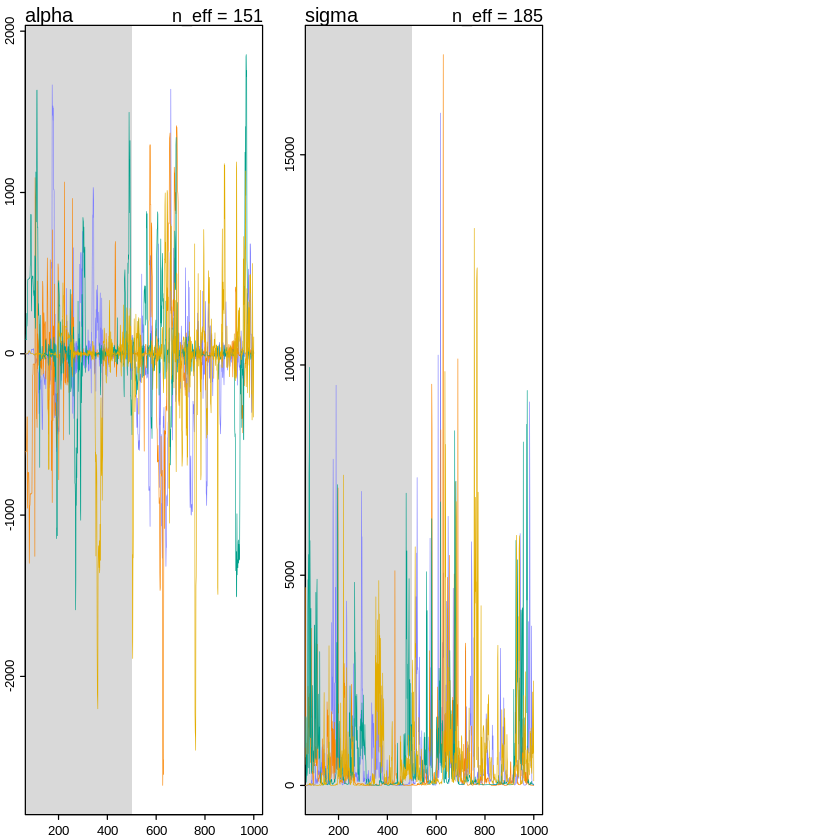

In [19]:
traceplot(m9.2)

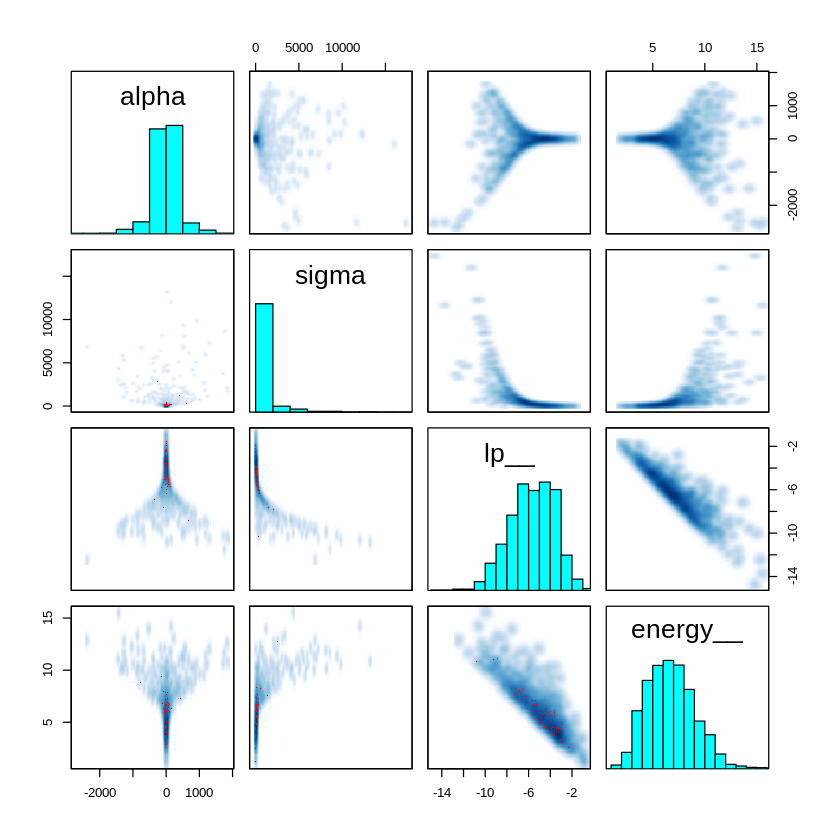

In [20]:
pairs( m9.2@stanfit )

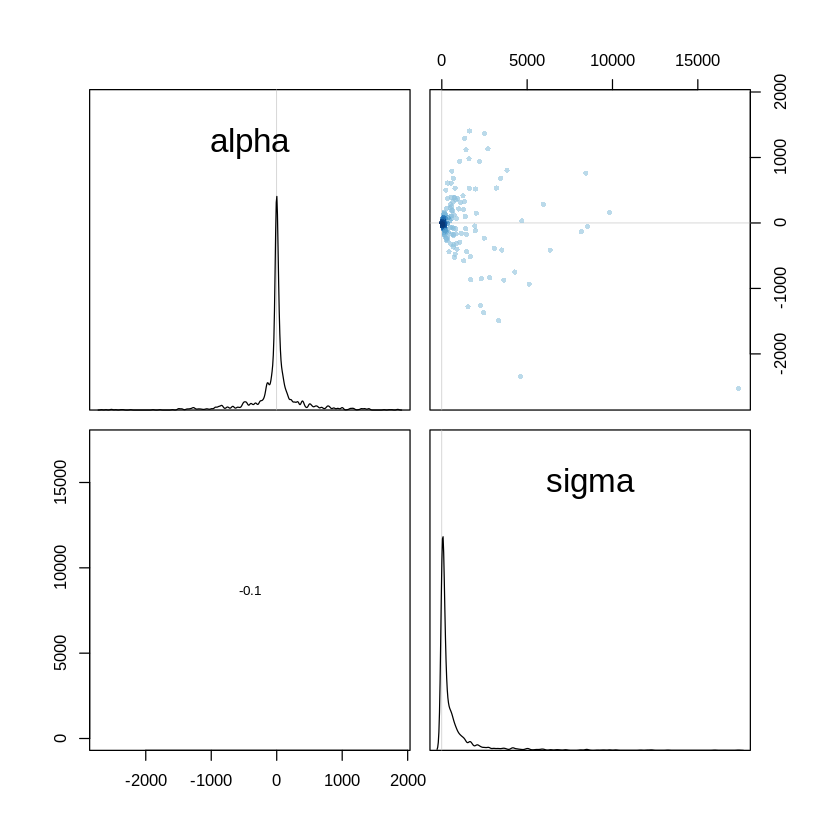

In [21]:
pairs(m9.2)

In [22]:
set.seed(11)

m9.3 <- ulam(
    alist(
        y ~ dnorm( mu , sigma ) ,
        mu <- alpha ,
        alpha ~ dnorm( 1 , 10 ) ,
        sigma ~ dexp( 1 )
        ) ,
        data=list(y=y) , chains=4 )

Cautionary note:
Variable y contains only integers but is not type 'integer'. If you intend it as an index variable, you should as.integer() it before passing to ulam.



SAMPLING FOR MODEL 'db8b93ccfa83872ce482c35ebed2c618' NOW (CHAIN 1).
Chain 1: 
Chain 1: Gradient evaluation took 8e-06 seconds
Chain 1: 1000 transitions using 10 leapfrog steps per transition would take 0.08 seconds.
Chain 1: Adjust your expectations accordingly!
Chain 1: 
Chain 1: 
Chain 1: Iteration:   1 / 1000 [  0%]  (Warmup)
Chain 1: Iteration: 100 / 1000 [ 10%]  (Warmup)
Chain 1: Iteration: 200 / 1000 [ 20%]  (Warmup)
Chain 1: Iteration: 300 / 1000 [ 30%]  (Warmup)
Chain 1: Iteration: 400 / 1000 [ 40%]  (Warmup)
Chain 1: Iteration: 500 / 1000 [ 50%]  (Warmup)
Chain 1: Iteration: 501 / 1000 [ 50%]  (Sampling)
Chain 1: Iteration: 600 / 1000 [ 60%]  (Sampling)
Chain 1: Iteration: 700 / 1000 [ 70%]  (Sampling)
Chain 1: Iteration: 800 / 1000 [ 80%]  (Sampling)
Chain 1: Iteration: 900 / 1000 [ 90%]  (Sampling)
Chain 1: Iteration: 1000 / 1000 [100%]  (Sampling)
Chain 1: 
Chain 1:  Elapsed Time: 0.009104 seconds (Warm-up)
Chain 1:                0.009012 seconds (Sampling)
Chain 1:     

In [23]:
precis(m9.3)

,mean,sd,5.5%,94.5%,n_eff,Rhat
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
alpha,0.122569,1.1902818,-1.5694743,2.030922,547.1008,1.001662
sigma,1.508886,0.7578693,0.6482903,2.895074,522.2370,1.002927


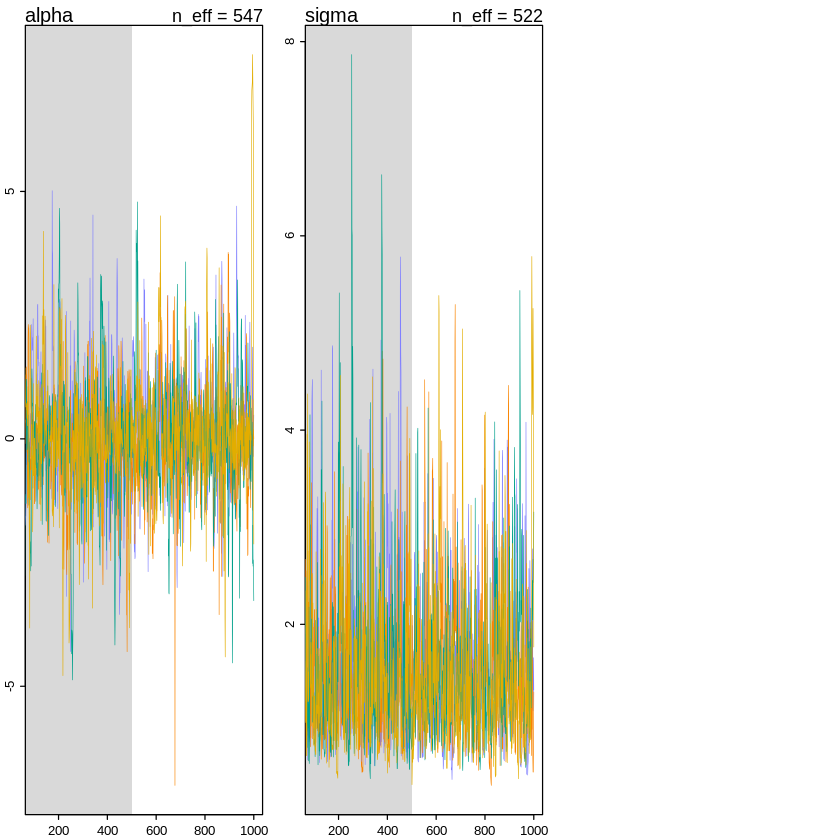

In [24]:
traceplot(m9.3)

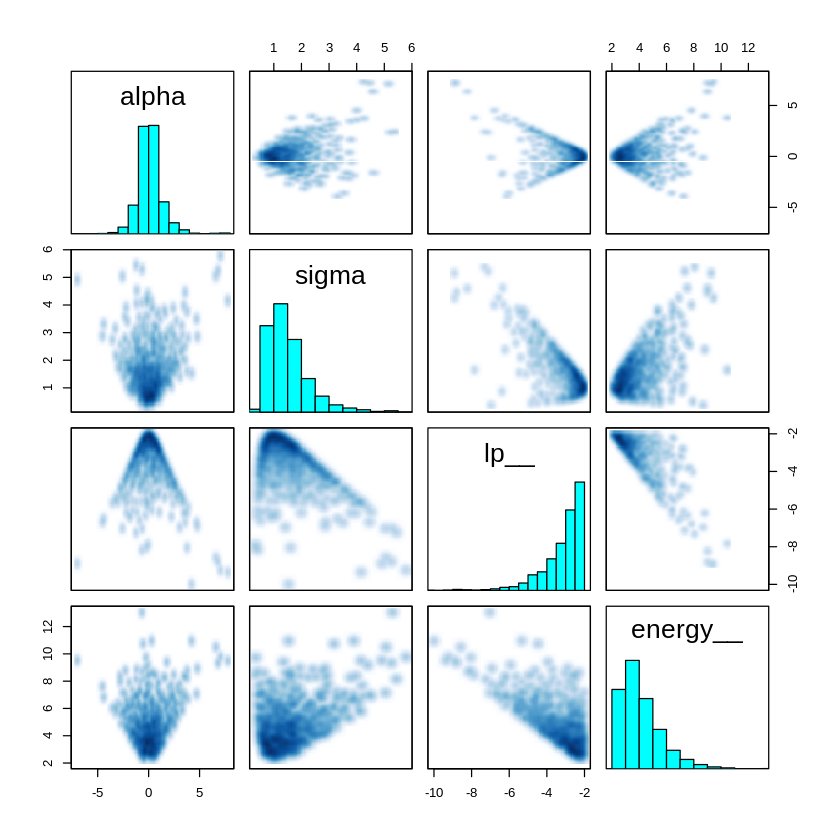

In [25]:
pairs( m9.3@stanfit )

In [26]:
set.seed(41)
y <- rnorm( 100 , mean=0 , sd=1 )

In [27]:
m9.4new <- ulam(
            alist(    
                y ~ dnorm( mu, sigma),
                mu <- a1 + a2,
                a1 ~ dnorm( 0, 1000),
                a2 ~ dnorm( 0, 1000),
                sigma ~ dexp(1)
                ) ,
            data=list(y=y) , chains=4, cores=4
            , control=list(max_treedepth=30)
            )

precis( m9.4new )

,mean,sd,5.5%,94.5%,n_eff,Rhat
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
a1,7.379953,706.44610433,-1106.6767281,1151.018145,500.9305,1.002558
a2,-7.192582,706.44079755,-1150.8354467,1106.806386,500.9381,1.002557
sigma,1.030363,0.07513976,0.9200364,1.154099,789.9197,1.001621


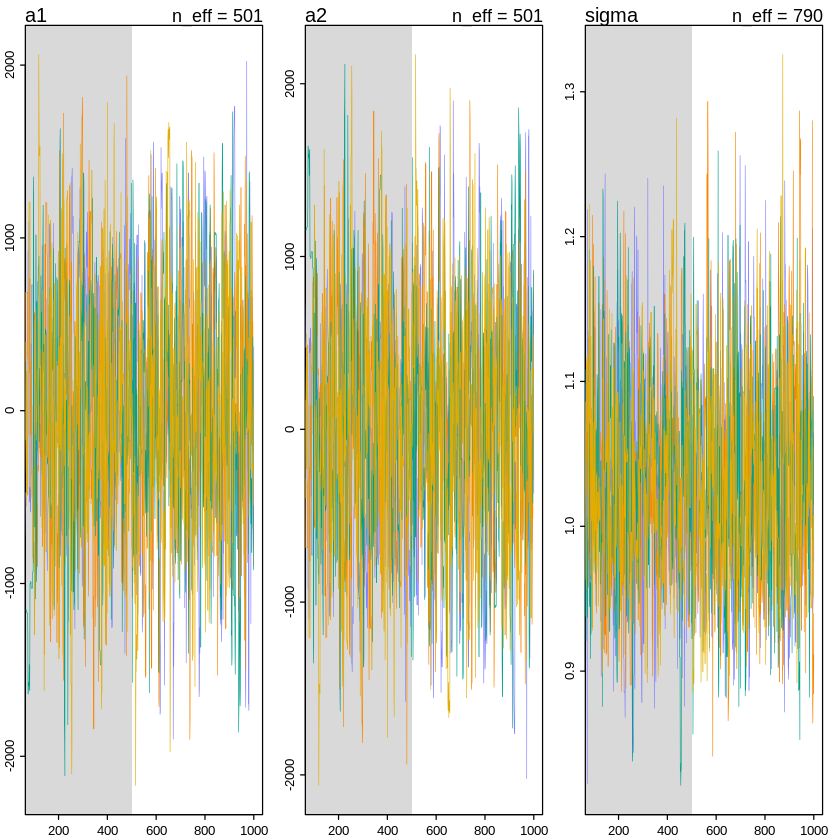

In [28]:
traceplot(m9.4new)

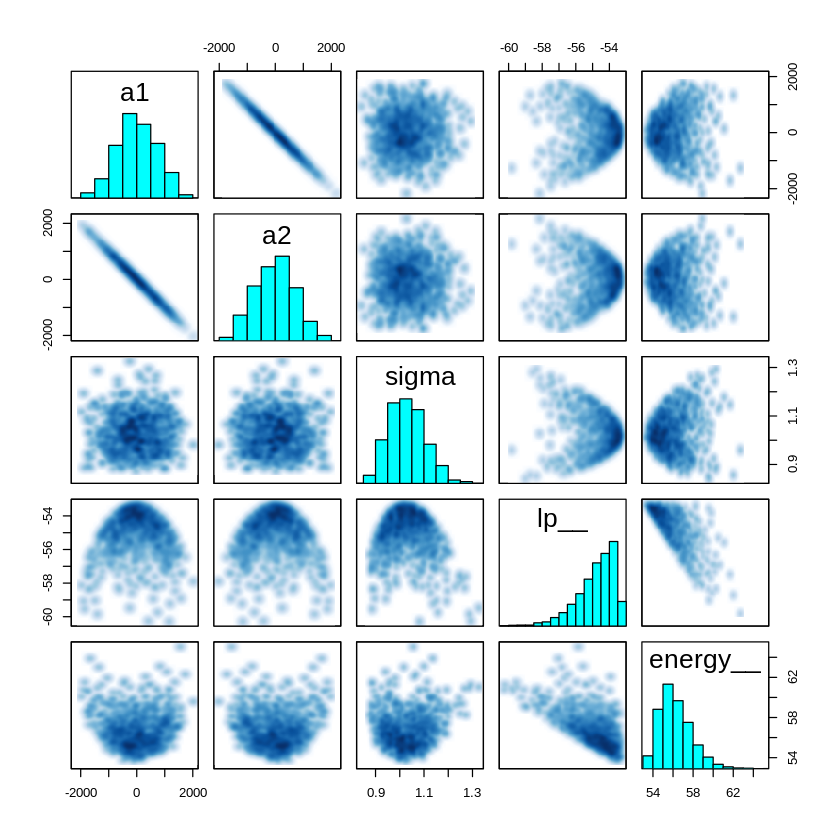

In [29]:
pairs(m9.4new@stanfit)

In [30]:
m9.4 <- ulam(
            alist(    
                y ~ dnorm( mu, sigma),
                mu <- a1 + a2,
                a1 ~ dnorm( 0, 1000),
                a2 ~ dnorm( 0, 1000),
                sigma ~ dexp(1)
                ) ,
            data=list(y=y) , chains=4, cores=4
#            , control=list(max_treedepth=30)
            )

precis( m9.4 )

recompiling to avoid crashing R session
Warning message:
“There were 1569 transitions after warmup that exceeded the maximum treedepth. Increase max_treedepth above 10. See
http://mc-stan.org/misc/warnings.html#maximum-treedepth-exceeded”Warning message:
“Examine the pairs() plot to diagnose sampling problems
”

,mean,sd,5.5%,94.5%,n_eff,Rhat
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
a1,-215.246392,367.14116570,-590.7730370,655.480607,3.013852,2.769334
a2,215.443097,367.14114447,-655.0515160,590.960570,3.013881,2.769328
sigma,1.060861,0.07436332,0.9439156,1.168378,21.439430,1.187113


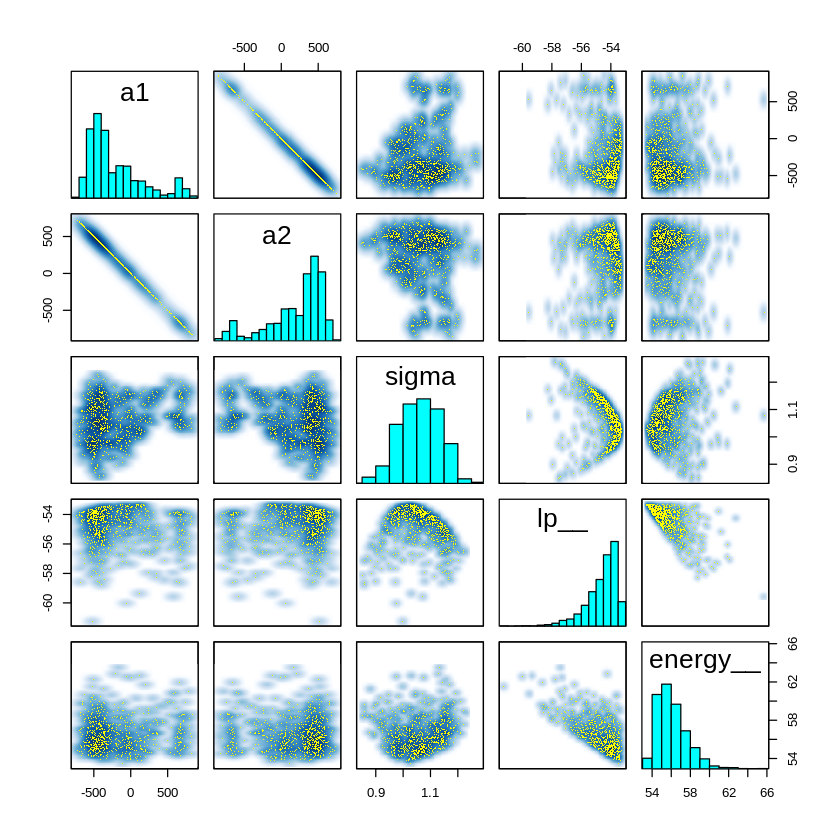

In [31]:
pairs(m9.4@stanfit)

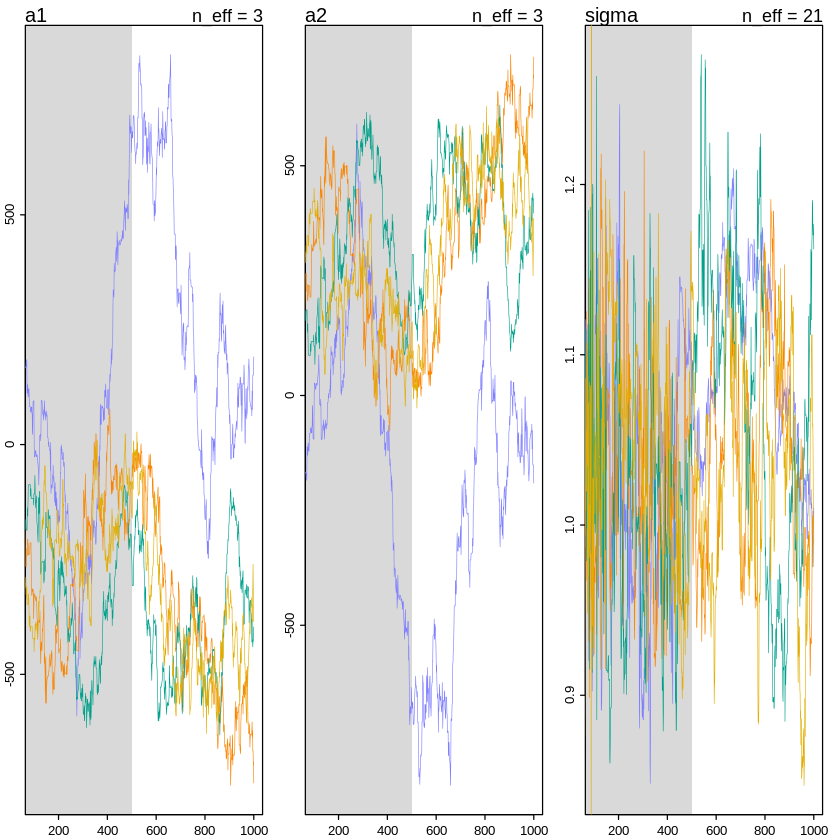

In [32]:
traceplot(m9.4)

In [33]:
m9.5 <- ulam(
    alist(
    y ~ dnorm( mu , sigma ) ,
    mu <- a1 + a2 ,
    a1 ~ dnorm( 0 , 10 ),
    a2 ~ dnorm( 0 , 10 ),
    sigma ~ dexp( 1 )
    ) ,
    data=list(y=y) , chains=4, cores=4 )

precis( m9.5 )

,mean,sd,5.5%,94.5%,n_eff,Rhat
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
a1,-0.1311095,7.22787011,-11.4515337,11.276302,593.6340,1.013674
a2,0.3222445,7.22793375,-11.1580286,11.628507,593.2314,1.013698
sigma,1.0343679,0.07234703,0.9261772,1.157267,641.1217,1.007126


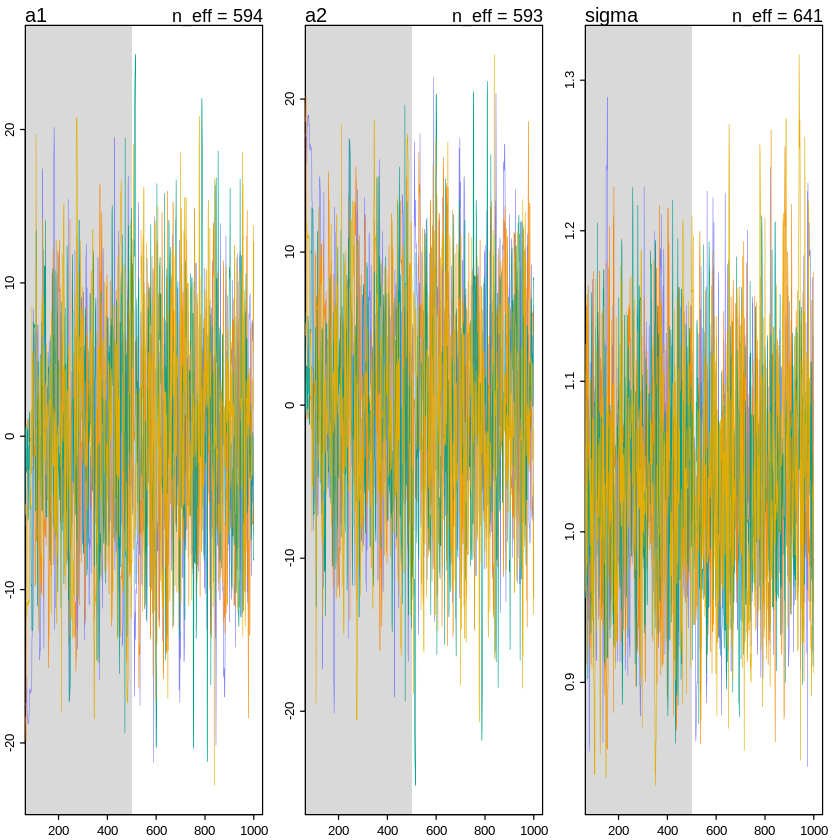

In [34]:
traceplot(m9.5)

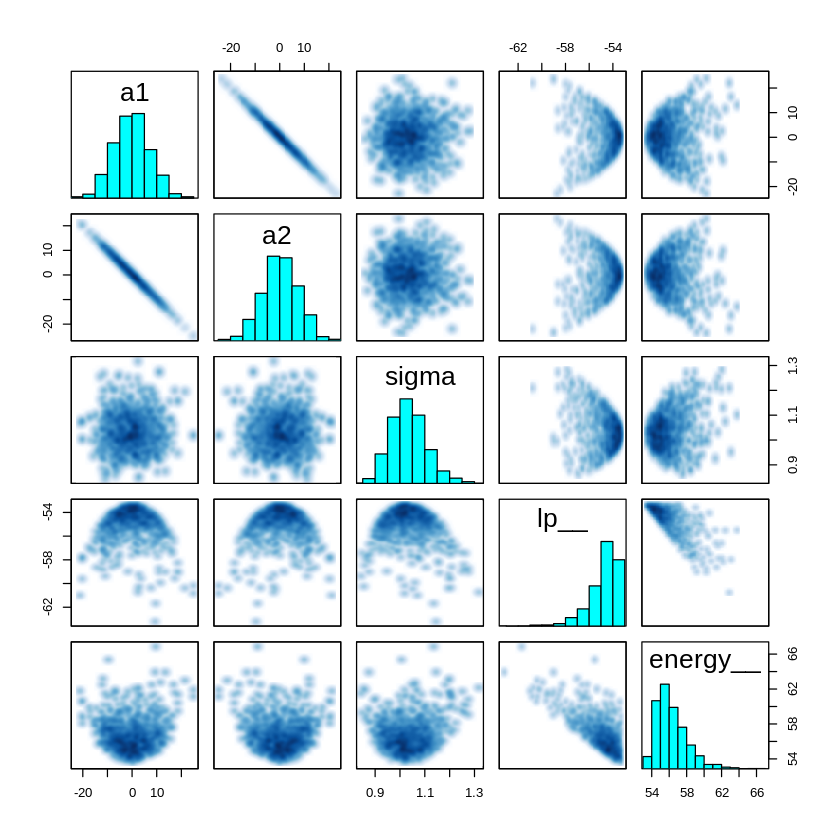

In [35]:
pairs(m9.5@stanfit)

Practice

8E1 - need symmetric proposals:

"Provided the way we choose our proposed parameter values at each step is symmetric—so
that there is an equal chance of proposing from A to B and from B to A—then the Metropolis
algorithm will eventually give us a collection of samples from the joint posterior."

8E2

Asymmetric proposals are allowed.  This allows savvy propoosals to sample the parameter space more efficiently.

"The most common way to generate savvy proposals is a technique known as Gibbs sampling. Gibbs sampling is a variant of the Metropolis-Hastings algorithm that uses clever
proposals and is therefore more efficient. By “efficient,” I mean that you can get a good
estimate of the posterior from Gibbs sampling with many fewer samples than a comparable
Metropolis approach. The improvement arises from adaptive proposals in which the distribution of proposed parameter values adjusts itself intelligently, depending upon the parameter
values at the moment.  
How Gibbs sampling computes these adaptive proposals depends upon using particular combinations of prior distributions and likelihoods known as conjugate pairs. Conjugate
pairs have analytical solutions for the posterior distribution of an individual parameter. And
these solutions are what allow Gibbs sampling to make smart jumps around the joint posterior distribution of all parameters...

There are some severe limitations to Gibbs sampling.
First, maybe you don’t want to use conjugate priors. Some conjugate priors are actually
pathological in shape, once you start building multilevel models and need priors for entire
covariance matrixes.  
Second, as models become more complex and contain hundreds or thousands or tens
of thousands of parameters, both Metropolis and Gibbs sampling become shockingly inefficient. The reason is that they tend to get stuck in small regions of the posterior for potentially
a long time. The high number of parameters isn’t the problem so much as the fact that models with many parameters nearly always have regions of high correlation in the posterior.
This means that two or more parameters are highly correlated with one another in the posterior samples.  Why is this a problem? Because high correlation means a narrow ridge of high probability
combinations, and both Metropolis and Gibbs make too many dumb proposals of where to
go next. So they get stuck."

From https://github.com/jffist/statistical-rethinking-solutions/blob/master/ch08_hw.R#L9:
"Gibbs sampling leverages information about the analytic form of likelihood and conjugate priors, so it can merge proposal and reject/accept steps."

8E3 The Hamiltonian MCMC cannot handle discrete parameters as it requires the gradient of the log probability space in order to determine the sequence of samples of the parameter space (move around the parameter space).


From https://github.com/jffist/statistical-rethinking-solutions/blob/master/ch08_hw.R#L9: 
"Hamiltonian Monte Carlo method couldn't handle discrete parameters. Method is based on the physical metaphor of the moving particle. This particle moves in the space of parameters with speed proportional to the gradient of likelihood, so the method should be able to differentiate the space. Discrete parameters aren't differentiable."

8E4 The actual number of samples is the number of samples from the posterior, which is the number of updates from the Hamiltonian MCMC process.

Because the Hamiltonian MCMC uses (local - gradient) information about the log probability surface to navigate around the parameter space, it can efficiently sample from the space in such a way that is better than a purely random sample with autocorrelation of 0.  Thus, the 'effective' number of samples reflects the additional number of samples it would have taken to explore the parameter space to an equivalent extent, had they not been sampled in the efficient HMCMC way.

From https://github.com/jffist/statistical-rethinking-solutions/blob/master/ch08_hw.R#L9: 
"N_effective aims to estimate the number of 'ideal' samples. Ideal samples are entirely uncorrelated. Due to way MCMC works each next sample is actually correlated with the previous one to some extent. n_eff estimate how many independent samples we should get to collect same information as presented by the current sequence of posterior samples."

From the book, "When n_eff is much lower than the actual number of
iterations (minus warmup) of your chains, it means the chains are inefficient, but possibly still okay."

8E5 Rhat (the Gelman-Rubin convergence diagnostic) should approach the value of 1 (from above), when a chain is sampling the posterior distribution correctly.  It corresponds to an F(?) statistic - measuring the ratio of in-chain to across chain variance in the samples.  Note that Rhat = 1 is not an indicator of a well functioning HMCMC, but an Rhat > 1 is an indicator of a poorly functioning HMCMC.  So it doesn't indicate we are safe, but it does indicate when we are not.

From https://github.com/jffist/statistical-rethinking-solutions/blob/master/ch08_hw.R#L9: 
"Rhat should be close to 1. It reflects the fact that inner variance and outer variance between chains is roughly the same, so we could expect that inference is not broken (does't depend on the chain)."

From the book:
"When Rhat is above 1.00, it usually indicates that the chain has not yet converged, and probably you
shouldn’t trust the samples. If you draw more iterations, it could be fine, or it could never converge."

8E6 The author calls a good traceplot (in the lectures) a "hairy caterpillar".

Key things of a good traceplot:
a) Stationary.  (Weak stationarity: The moments of the stochastic process that is the chain should be constant.) From the book:
Stationarity refers to the path
of each chain staying within the same high-probability portion of the posterior distribution.
Notice that these traces, for example, all stick around a very stable central tendency, the
center of gravity of each dimension of the posterior. Another way to think of this is that
the mean value of the chain is quite stable from beginning to end.

b) Well mixed - it samples across all regions of the parater space.  From the book:
Good mixing means that the chain rapidly explores the full region. It doesn’t slowly wander, but rather rapidly
zig-zags around, as a good Hamiltonian chain should.

c) Convergent.  From the book:
Convergence means that multiple,
independent chains stick around the same region of high probability.

8M1



In [36]:
library(rethinking)
data(rugged)
d <- rugged

d$log_gdp <- log(d$rgdppc_2000)
dd <- d[ complete.cases(d$rgdppc_2000) , ]
dd$log_gdp_std <- dd$log_gdp / mean(dd$log_gdp)
dd$rugged_std <- dd$rugged / max(dd$rugged)
dd$cid <- ifelse( dd$cont_africa==1 , as.integer(1) , as.integer(2) )

dat_slim <- data.frame(
log_gdp_std = dd$log_gdp_std,
rugged_std = dd$rugged_std,
cid = as.integer( dd$cid )
)
str(dat_slim)

dd.trim <- dd[ , c("log_gdp_std","rugged_std","cid") ]

mean(dd$rugged_std)

'data.frame':	170 obs. of  3 variables:
 $ log_gdp_std: num  0.88 0.965 1.166 1.104 0.915 ...
 $ rugged_std : num  0.138 0.553 0.124 0.125 0.433 ...
 $ cid        : int  1 2 2 2 2 2 2 2 2 1 ...


[1] 0.2149601

In [37]:
# #install.packages("microbenchmark")
# #library(microbenchmark)
# require(microbenchmark)
# times <- microbenchmark( times=3,
#                         m8m1unif,                      
#                         m8m1exp
#                         ); 

# #example(microbenchmark)
# times

In [38]:
m8m1unif <- ulam(
            alist(
                log_gdp_std ~ dnorm(mu, sigma),
                mu <- a[cid] + b[cid] * (rugged_std - 0.215),
                a[cid] ~ dnorm(1,0.2),
                b[cid] ~ dnorm(0,0.3),
                sigma ~ dunif(0,10)
            ),
#            data=dat_slim, 
            data=dd.trim, 
            chains=4, cores=4
            )

In [39]:
m8m1exp <- ulam(
            alist(
                log_gdp_std ~ dnorm(mu, sigma),
                mu <- a[cid] + b[cid] * (rugged_std - 0.215),
                a[cid] ~ dnorm(1,0.2),
                b[cid] ~ dnorm(0,0.3),
                sigma ~ dexp(1)
            ),
#            data=dat_slim, 
            data=dd.trim, 
            chains=4, cores=4
            )

In [40]:
precis(m8m1unif, depth=2)

,mean,sd,5.5%,94.5%,n_eff,Rhat
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
a[1],0.8846014,0.015975180,0.85903484,0.91024997,2488.274,0.9992620
a[2],1.0510686,0.009891611,1.03480399,1.06660695,3135.597,0.9985520
b[1],0.1308761,0.076318439,0.01187636,0.25052103,2358.176,0.9991011
b[2],-0.1422994,0.055637414,-0.23018104,-0.05246198,1993.136,0.9998064
sigma,0.1115920,0.005908023,0.10233909,0.12145983,2966.390,0.9984568


In [41]:
precis(m8m1exp, depth=2)

,mean,sd,5.5%,94.5%,n_eff,Rhat
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
a[1],0.8840707,0.016579266,0.856905157,0.91103115,2277.925,0.9992740
a[2],1.0507977,0.010134843,1.034556462,1.06671786,3008.239,1.0001246
b[1],0.1292933,0.076022465,0.008499808,0.24829361,2291.058,0.9989584
b[2],-0.1436360,0.056491443,-0.235443557,-0.05570446,2340.378,1.0004087
sigma,0.1117792,0.006197423,0.102351049,0.12196222,2668.895,1.0002858


There appears to be no discernable difference between using the unif(0,10) or exp(1) prior for sigma from the precis.  What about the other methods of analysis:

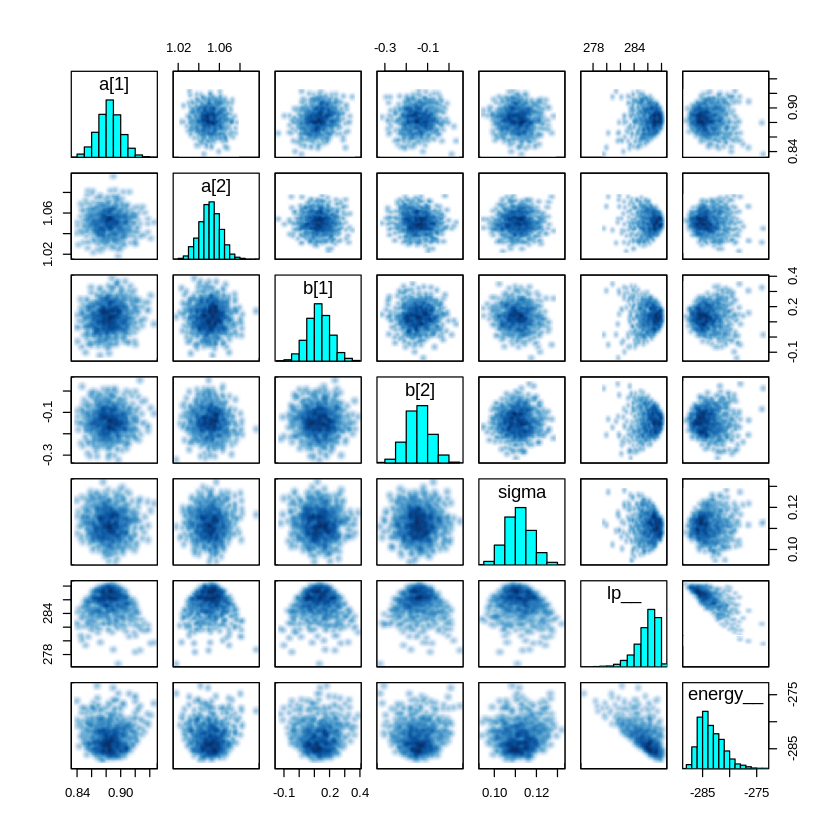

In [42]:
pairs(m8m1unif@stanfit)

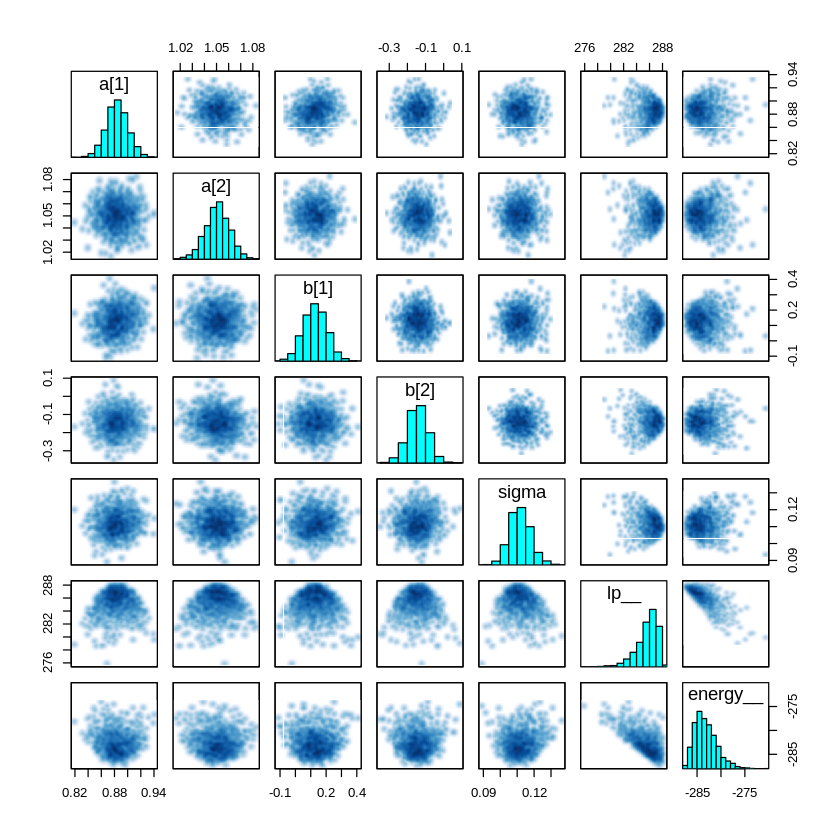

In [43]:
pairs(m8m1exp@stanfit)

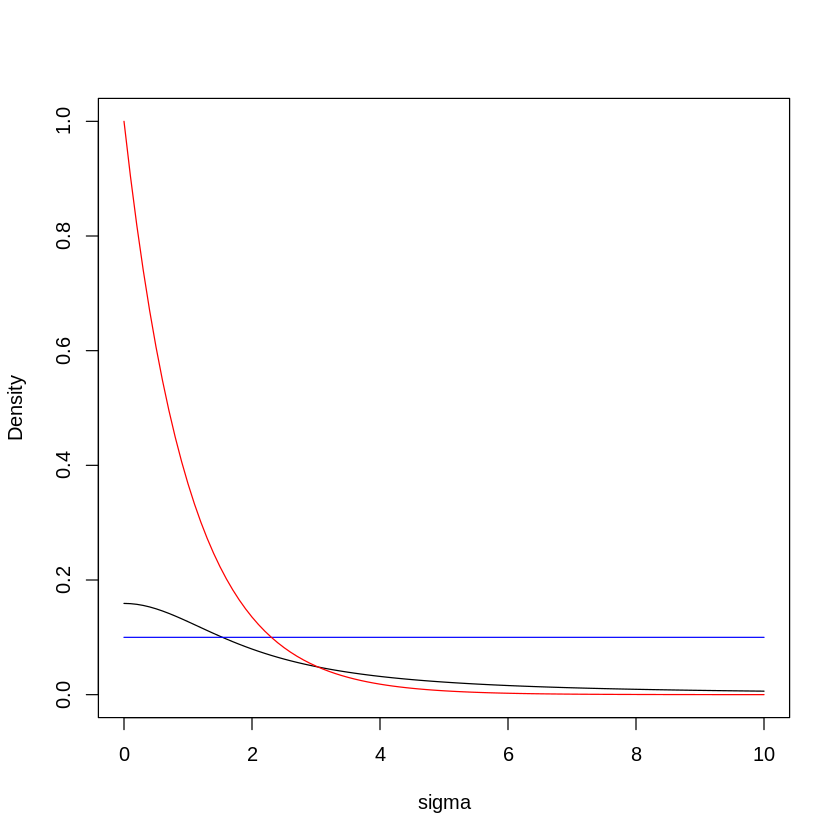

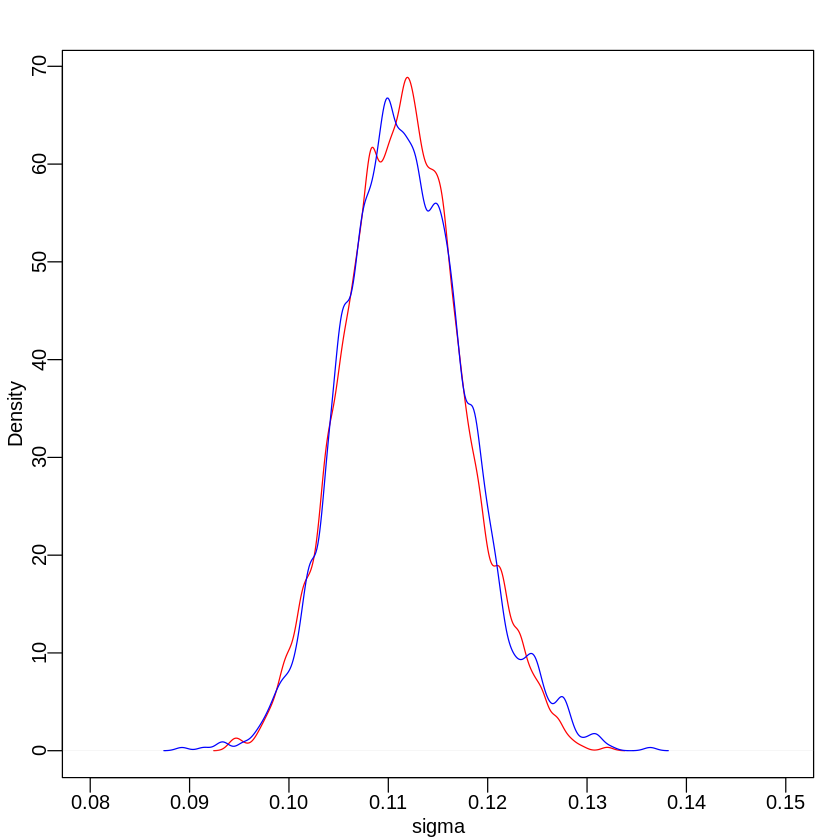

In [44]:
# visualize each prior
curve(dcauchy(x, 0, 2), from = 0, to = 10, xlab = "sigma", ylab = "Density", ylim = c(0, 1))
curve(dunif(x, 0, 10), from = 0, to = 10, add = TRUE, col = "blue")
curve(dexp(x, 1), from = 0, to = 10, add = TRUE, col = "red")

# plot the posterior for sigma for each model
sigma_unif <- extract.samples(m8m1unif,pars="sigma")
sigma_exp <- extract.samples(m8m1exp,pars="sigma")
dens(sigma_unif[[1]], xlab="sigma", xlim=c(0.08,0.15), col="red")
dens(sigma_exp[[1]], add=TRUE, col="blue")


Also, there is no discernable difference between the posteriors of sigma using the 2 different priors.

8M2


Let's explore the Cauchy priors first.

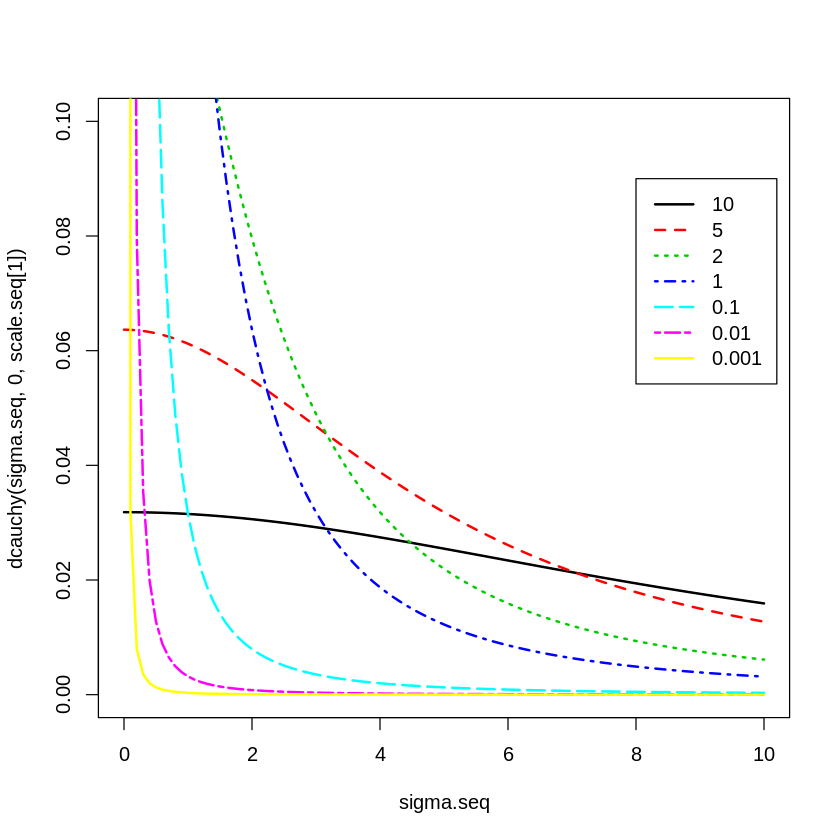

In [45]:
#From https://github.com/jffist/statistical-rethinking-solutions/blob/master/ch08_hw.R#L9:

scale.seq <- c(10, 5, 2, 1, 0.1, 0.01, 0.001)
sigma.seq <- seq(0,10, by=0.1)
## cauchy ##
## priors
i=1
n=length(scale.seq)
plot(sigma.seq, dcauchy(sigma.seq, 0, scale.seq[1]), type='l', xlim=c(0,10), ylim=c(0,0.1), col=i)
for(scale in scale.seq){
  lines(sigma.seq, dcauchy(sigma.seq, 0, scale), type='l', col=i, lty=i, lwd=2)
  i=i+1
}
legend(8, 0.09, legend=scale.seq, col=1:n,  lty=1:n, lwd=2)

In [46]:
#?dcauchy

In [47]:
m8m1cauchy10 <- ulam(
            alist(
                log_gdp_std ~ dnorm(mu, sigma),
                mu <- a[cid] + b[cid] * (rugged_std - 0.215),
                a[cid] ~ dnorm(1,0.2),
                b[cid] ~ dnorm(0,0.3),
                sigma ~ dcauchy(0,10)
            ),
            data=dat_slim, 
#            data=dd.trim, 
            chains=4, cores=4
            )

In [48]:
m8m1cauchy5 <- ulam(
            alist(
                log_gdp_std ~ dnorm(mu, sigma),
                mu <- a[cid] + b[cid] * (rugged_std - 0.215),
                a[cid] ~ dnorm(1,0.2),
                b[cid] ~ dnorm(0,0.3),
                sigma ~ dcauchy(0, 5)
            ),
            data=dat_slim, 
#            data=dd.trim, 
            chains=4, cores=4
            )

In [49]:
m8m1cauchy1 <- ulam(
            alist(
                log_gdp_std ~ dnorm(mu, sigma),
                mu <- a[cid] + b[cid] * (rugged_std - 0.215),
                a[cid] ~ dnorm(1,0.2),
                b[cid] ~ dnorm(0,0.3),
                sigma ~ dcauchy(0, 1)
            ),
            data=dat_slim, 
#            data=dd.trim, 
            chains=4, cores=4
            )

In [50]:
m8m1cauchy0.1 <- ulam(
            alist(
                log_gdp_std ~ dnorm(mu, sigma),
                mu <- a[cid] + b[cid] * (rugged_std - 0.215),
                a[cid] ~ dnorm(1,0.2),
                b[cid] ~ dnorm(0,0.3),
                sigma ~ dcauchy(0, 0.1)
            ),
            data=dat_slim, 
#            data=dd.trim, 
            chains=4, cores=4
            )

In [51]:
m8m1cauchy0.01 <- ulam(
            alist(
                log_gdp_std ~ dnorm(mu, sigma),
                mu <- a[cid] + b[cid] * (rugged_std - 0.215),
                a[cid] ~ dnorm(1,0.2),
                b[cid] ~ dnorm(0,0.3),
                sigma ~ dcauchy(0, 0.01)
            ),
            data=dat_slim, 
#            data=dd.trim, 
            chains=4, cores=4
            )

In [52]:
m8m1cauchy0.001 <- ulam(
            alist(
                log_gdp_std ~ dnorm(mu, sigma),
                mu <- a[cid] + b[cid] * (rugged_std - 0.215),
                a[cid] ~ dnorm(1,0.2),
                b[cid] ~ dnorm(0,0.3),
                sigma ~ dcauchy(0, 0.001)
            ),
            data=dat_slim, 
#            data=dd.trim, 
            chains=4, cores=4
            )

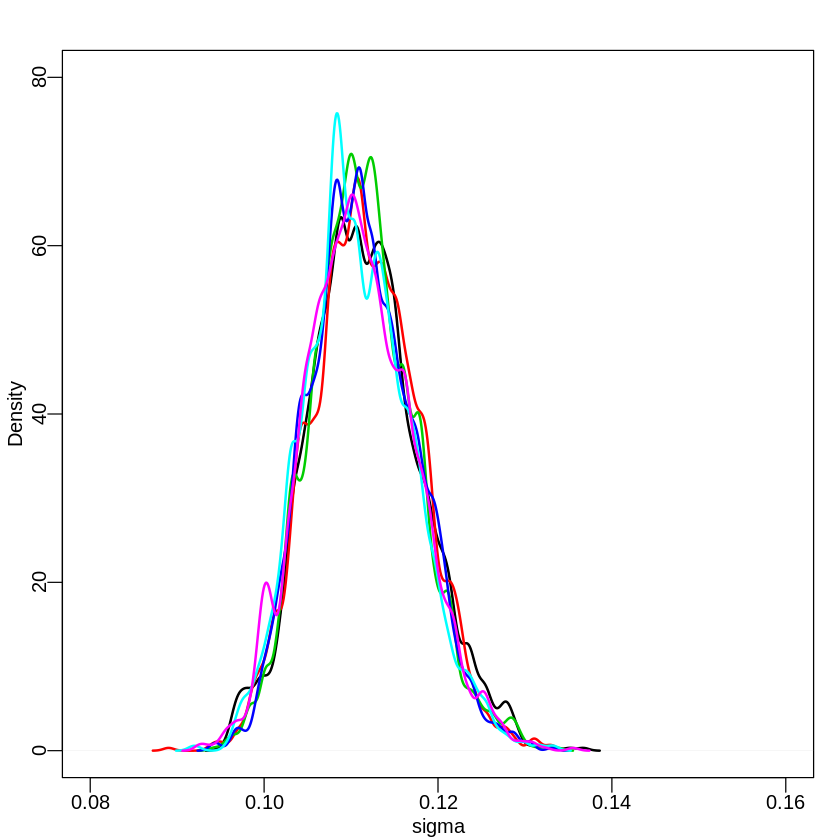

In [53]:
sigma.samples <- list(
  '10'=extract.samples( m8m1cauchy10)$sigma,
  '5'=extract.samples( m8m1cauchy5)$sigma,
  '1'=extract.samples( m8m1cauchy1)$sigma,
  '0.1'=extract.samples( m8m1cauchy0.1)$sigma,
  '0.01'=extract.samples( m8m1cauchy0.01)$sigma,
  '0.001'=extract.samples( m8m1cauchy0.001)$sigma
)
i=1
n=length(sigma.samples)
dens(sigma.samples[['10']], xlab="sigma", xlim=c(0.08,0.16), ylim=c(0,80), col=i)
for(scale.name in names(sigma.samples)){
  dens(sigma.samples[[scale.name]], col=i, add=T, lwd=2)
  i=i+1
}
legend(1.1, 8, legend=names(sigma.samples), col=1:n,  lwd=2)


Now let's explore the exponential priors.

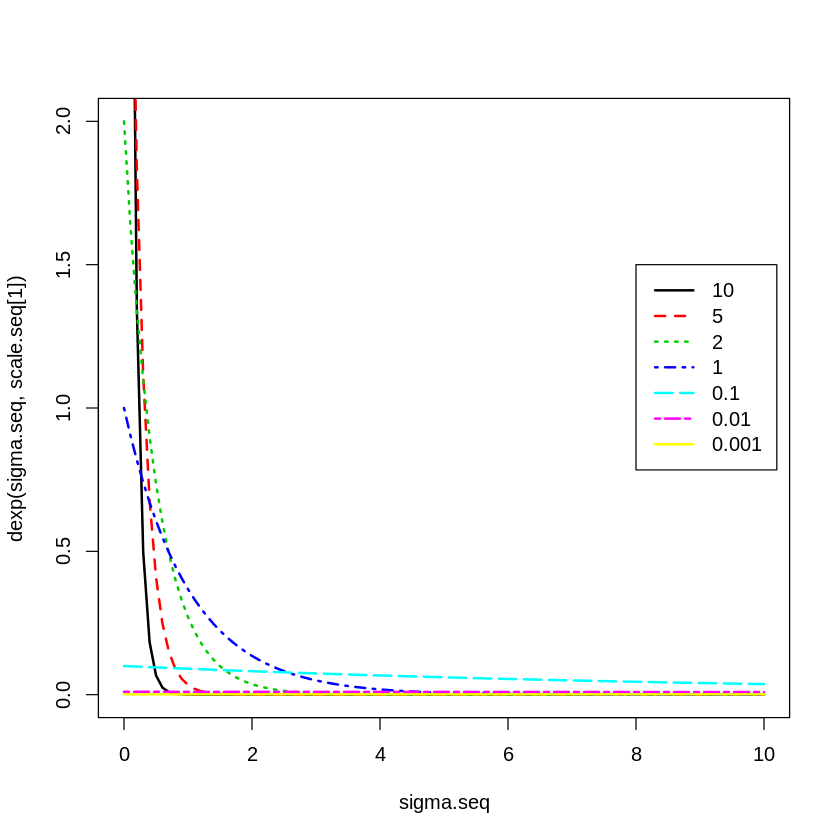

In [54]:
# From https://github.com/jffist/statistical-rethinking-solutions/blob/master/ch08_hw.R#L9:

cale.seq <- c(10, 5, 2, 1, 0.1, 0.01, 0.001)
sigma.seq <- seq(0,10, by=0.1)
## exp ##
## priors
i=1
n=length(scale.seq)
plot(sigma.seq, dexp(sigma.seq, scale.seq[1]), type='l', xlim=c(0,10), ylim=c(0,2), col=i)
for(scale in scale.seq){
  lines(sigma.seq, dexp(sigma.seq,  scale), type='l', col=i, lty=i, lwd=2)
  i=i+1
}
legend(8, 1.5, legend=scale.seq, col=1:n,  lty=1:n, lwd=2)

In [55]:
m8m1exp10 <- ulam(
            alist(
                log_gdp_std ~ dnorm(mu, sigma),
                mu <- a[cid] + b[cid] * (rugged_std - 0.215),
                a[cid] ~ dnorm(1,0.2),
                b[cid] ~ dnorm(0,0.3),
                sigma ~ dexp(10)
            ),
            data=dat_slim, 
#            data=dd.trim, 
            chains=4, cores=4
            )

In [56]:
m8m1exp5 <- ulam(
            alist(
                log_gdp_std ~ dnorm(mu, sigma),
                mu <- a[cid] + b[cid] * (rugged_std - 0.215),
                a[cid] ~ dnorm(1,0.2),
                b[cid] ~ dnorm(0,0.3),
                sigma ~ dexp(5)
            ),
            data=dat_slim, 
#            data=dd.trim, 
            chains=4, cores=4
            )

In [57]:
m8m1exp1 <- ulam(
            alist(
                log_gdp_std ~ dnorm(mu, sigma),
                mu <- a[cid] + b[cid] * (rugged_std - 0.215),
                a[cid] ~ dnorm(1,0.2),
                b[cid] ~ dnorm(0,0.3),
                sigma ~ dexp(1)
            ),
            data=dat_slim, 
#            data=dd.trim, 
            chains=4, cores=4
            )

recompiling to avoid crashing R session


In [58]:
m8m1exp0.1 <- ulam(
            alist(
                log_gdp_std ~ dnorm(mu, sigma),
                mu <- a[cid] + b[cid] * (rugged_std - 0.215),
                a[cid] ~ dnorm(1,0.2),
                b[cid] ~ dnorm(0,0.3),
                sigma ~ dexp(0.1)
            ),
            data=dat_slim, 
#            data=dd.trim, 
            chains=4, cores=4
            )

In [59]:
m8m1exp0.01 <- ulam(
            alist(
                log_gdp_std ~ dnorm(mu, sigma),
                mu <- a[cid] + b[cid] * (rugged_std - 0.215),
                a[cid] ~ dnorm(1,0.2),
                b[cid] ~ dnorm(0,0.3),
                sigma ~ dexp(0.1)
            ),
            data=dat_slim, 
#            data=dd.trim, 
            chains=4, cores=4
            )

recompiling to avoid crashing R session


In [60]:
m8m1exp0.001 <- ulam(
            alist(
                log_gdp_std ~ dnorm(mu, sigma),
                mu <- a[cid] + b[cid] * (rugged_std - 0.215),
                a[cid] ~ dnorm(1,0.2),
                b[cid] ~ dnorm(0,0.3),
                sigma ~ dexp(0.001)
            ),
            data=dat_slim, 
#            data=dd.trim, 
            chains=4, cores=4
            )

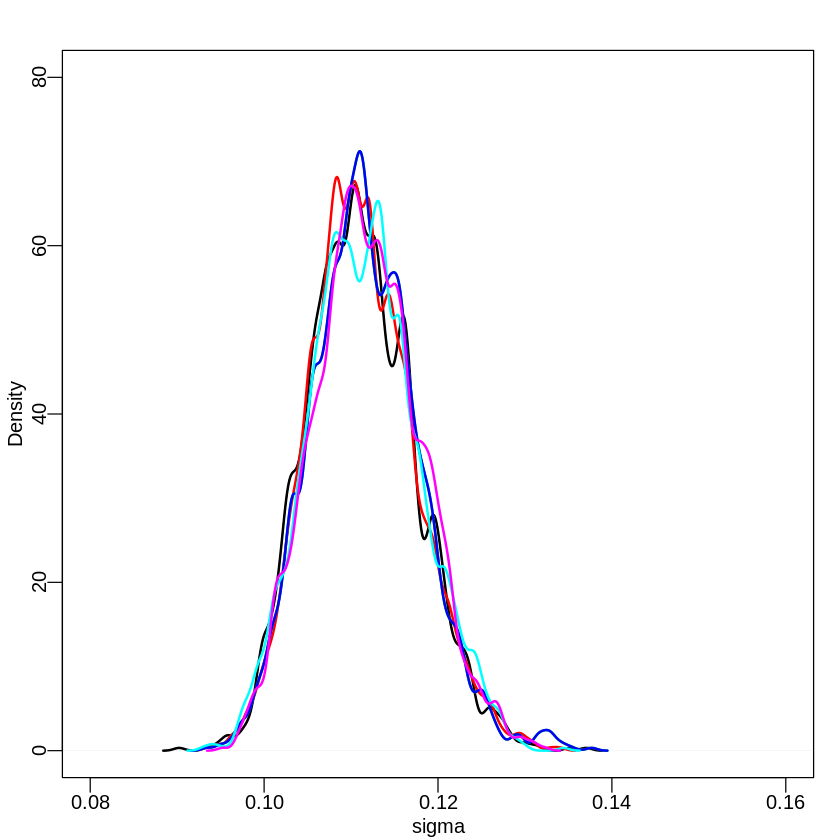

In [61]:
sigma.samples <- list(
  '10'=extract.samples( m8m1exp10)$sigma,
  '5'=extract.samples( m8m1exp5)$sigma,
  '1'=extract.samples( m8m1exp1)$sigma,
  '0.1'=extract.samples( m8m1exp1)$sigma,
  '0.01'=extract.samples( m8m1exp0.01)$sigma,
  '0.001'=extract.samples( m8m1exp0.001)$sigma
)
i=1
n=length(sigma.samples)
dens(sigma.samples[['10']], xlab="sigma", xlim=c(0.08, 0.16), ylim=c(0,80), col=i)
for(scale.name in names(sigma.samples)){
  dens(sigma.samples[[scale.name]], col=i, add=T, lwd=2)
  i=i+1
}
legend(1.1, 8, legend=names(sigma.samples), col=1:n,  lwd=2)

The scaling parameters of both the Cauchy and Exponential priors don't seem to have any discernable effect on the posterior of parameter Sigma.  What about the other parameters.  Let's have a look at the precis outputs.

In [62]:
precis(m8m1cauchy10, depth=2)

,mean,sd,5.5%,94.5%,n_eff,Rhat
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
a[1],0.8847057,0.016087942,0.85905261,0.91065745,2449.080,0.9991222
a[2],1.0506053,0.010068590,1.03471427,1.06653182,2962.926,1.0002688
b[1],0.1312741,0.075731516,0.01151259,0.25277778,2629.050,0.9991051
b[2],-0.1420994,0.057361058,-0.23277017,-0.05296107,2617.551,0.9985338
sigma,0.1117151,0.006422843,0.10216738,0.12269097,2849.347,0.9986852


In [63]:
precis(m8m1cauchy5, depth=2)

,mean,sd,5.5%,94.5%,n_eff,Rhat
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
a[1],0.8851196,0.015673954,0.86079796,0.91152335,2517.109,0.9996957
a[2],1.0508050,0.009893102,1.03481789,1.06646045,2876.955,0.9993391
b[1],0.1309963,0.074035417,0.01315503,0.24480231,1913.906,1.0002487
b[2],-0.1412615,0.055989388,-0.22700496,-0.05017413,2142.697,0.9989931
sigma,0.1116691,0.006150400,0.10206204,0.12163956,3533.271,0.9993448


In [64]:
precis(m8m1cauchy1, depth=2)

,mean,sd,5.5%,94.5%,n_eff,Rhat
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
a[1],0.8843388,0.016473061,0.85812411,0.91046815,2269.239,0.9994045
a[2],1.0506677,0.010415665,1.03377924,1.06743933,2990.264,0.9989353
b[1],0.1305814,0.076149213,0.01180194,0.24816678,2455.529,0.9992530
b[2],-0.1426322,0.056270519,-0.23168595,-0.05107005,2210.663,1.0005343
sigma,0.1114741,0.005932467,0.10265741,0.12124686,2886.787,1.0019751


In [65]:
precis(m8m1cauchy0.01, depth=2)

,mean,sd,5.5%,94.5%,n_eff,Rhat
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
a[1],0.8843258,0.015746489,0.858629043,0.9097487,2697.296,0.9984185
a[2],1.0507520,0.010218523,1.034604387,1.0671589,2775.069,0.9991815
b[1],0.1300543,0.074835922,0.007631061,0.2523194,2171.992,0.9987992
b[2],-0.1441048,0.055390823,-0.235543227,-0.0534424,2588.202,1.0010634
sigma,0.1108556,0.006117077,0.101710492,0.1210309,3568.665,0.9983720


In [66]:
precis(m8m1exp10, depth=2)

,mean,sd,5.5%,94.5%,n_eff,Rhat
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
a[1],0.8845237,0.016343061,0.85805981,0.91092998,3142.611,0.9986077
a[2],1.0510819,0.010732703,1.03406488,1.06825544,2611.742,0.9986151
b[1],0.1313951,0.074209451,0.01579533,0.25169280,2164.177,1.0010950
b[2],-0.1424209,0.053760756,-0.22854101,-0.05674178,2832.543,0.9990896
sigma,0.1111870,0.006177789,0.10185868,0.12137673,2159.164,0.9998758


In [67]:
precis(m8m1exp1, depth=2)

,mean,sd,5.5%,94.5%,n_eff,Rhat
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
a[1],0.8837946,0.016073962,0.85868363,0.90917097,2482.894,0.9989749
a[2],1.0508446,0.009903908,1.03478787,1.06705355,2918.592,0.9993116
b[1],0.1308745,0.072826185,0.01128541,0.24483233,2139.183,0.9993561
b[2],-0.1416833,0.055090903,-0.22921867,-0.05455067,2678.852,1.0001861
sigma,0.1116802,0.006251470,0.10225845,0.12191783,2299.991,0.9990279


In [68]:
precis(m8m1exp0.01, depth=2)

,mean,sd,5.5%,94.5%,n_eff,Rhat
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
a[1],0.8849954,0.016025865,0.8601059,0.90970955,2204.040,1.0007182
a[2],1.0507183,0.010279386,1.0341127,1.06680910,2825.159,0.9994050
b[1],0.1321327,0.073910701,0.0141127,0.25273319,1946.364,0.9991553
b[2],-0.1425583,0.053694401,-0.2300117,-0.05685094,2631.558,0.9994101
sigma,0.1115203,0.006256676,0.1017323,0.12206433,2459.408,0.9995897


No differnece in posterior of the other parameters too.  It seems that the 170 observations in the data are enough to overcome the priors.

8M3

In [69]:
m8m1warmup500 <- ulam(
            alist(
                log_gdp_std ~ dnorm(mu, sigma),
                mu <- a[cid] + b[cid] * (rugged_std - 0.215),
                a[cid] ~ dnorm(1,0.2),
                b[cid] ~ dnorm(0,0.3),
                sigma ~ dexp(1)
            ),
            data=dat_slim, 
#            data=dd.trim, 
            chains=4, cores=4,
            iter=1000,
            warmup=500            
            )

m8m1warmup500

recompiling to avoid crashing R session


Hamiltonian Monte Carlo approximation
2000 samples from 4 chains

Sampling durations (seconds):
        warmup sample total
chain:1   0.07   0.06  0.13
chain:2   0.08   0.06  0.14
chain:3   0.11   0.06  0.17
chain:4   0.09   0.06  0.15

Formula:
log_gdp_std ~ dnorm(mu, sigma)
mu <- a[cid] + b[cid] * (rugged_std - 0.215)
a[cid] ~ dnorm(1, 0.2)
b[cid] ~ dnorm(0, 0.3)
sigma ~ dexp(1)

In [70]:
m8m1warmup400 <- ulam(
            alist(
                log_gdp_std ~ dnorm(mu, sigma),
                mu <- a[cid] + b[cid] * (rugged_std - 0.215),
                a[cid] ~ dnorm(1,0.2),
                b[cid] ~ dnorm(0,0.3),
                sigma ~ dexp(1)
            ),
            data=dat_slim, 
#            data=dd.trim, 
            chains=4, cores=4,
            iter=900,
            warmup=400            
            )

m8m1warmup400

recompiling to avoid crashing R session


Hamiltonian Monte Carlo approximation
2000 samples from 4 chains

Sampling durations (seconds):
        warmup sample total
chain:1   0.08   0.06  0.14
chain:2   0.08   0.06  0.14
chain:3   0.09   0.06  0.15
chain:4   0.09   0.05  0.15

Formula:
log_gdp_std ~ dnorm(mu, sigma)
mu <- a[cid] + b[cid] * (rugged_std - 0.215)
a[cid] ~ dnorm(1, 0.2)
b[cid] ~ dnorm(0, 0.3)
sigma ~ dexp(1)

In [71]:
m8m1warmup300 <- ulam(
            alist(
                log_gdp_std ~ dnorm(mu, sigma),
                mu <- a[cid] + b[cid] * (rugged_std - 0.215),
                a[cid] ~ dnorm(1,0.2),
                b[cid] ~ dnorm(0,0.3),
                sigma ~ dexp(1)
            ),
            data=dat_slim, 
#            data=dd.trim, 
            chains=4, cores=4,
            iter=800,
            warmup=300            
            )

m8m1warmup300

recompiling to avoid crashing R session


Hamiltonian Monte Carlo approximation
2000 samples from 4 chains

Sampling durations (seconds):
        warmup sample total
chain:1   0.04   0.05  0.09
chain:2   0.06   0.06  0.12
chain:3   0.08   0.07  0.14
chain:4   0.07   0.06  0.13

Formula:
log_gdp_std ~ dnorm(mu, sigma)
mu <- a[cid] + b[cid] * (rugged_std - 0.215)
a[cid] ~ dnorm(1, 0.2)
b[cid] ~ dnorm(0, 0.3)
sigma ~ dexp(1)

In [72]:
m8m1warmup200 <- ulam(
            alist(
                log_gdp_std ~ dnorm(mu, sigma),
                mu <- a[cid] + b[cid] * (rugged_std - 0.215),
                a[cid] ~ dnorm(1,0.2),
                b[cid] ~ dnorm(0,0.3),
                sigma ~ dexp(1)
            ),
            data=dat_slim, 
#            data=dd.trim, 
            chains=4, cores=4,
            iter=700,
            warmup=200            
            )

m8m1warmup200

recompiling to avoid crashing R session


Hamiltonian Monte Carlo approximation
2000 samples from 4 chains

Sampling durations (seconds):
        warmup sample total
chain:1   0.07   0.06  0.13
chain:2   0.07   0.07  0.14
chain:3   0.06   0.06  0.11
chain:4   0.05   0.06  0.11

Formula:
log_gdp_std ~ dnorm(mu, sigma)
mu <- a[cid] + b[cid] * (rugged_std - 0.215)
a[cid] ~ dnorm(1, 0.2)
b[cid] ~ dnorm(0, 0.3)
sigma ~ dexp(1)

In [73]:
m8m1warmup100 <- ulam(
            alist(
                log_gdp_std ~ dnorm(mu, sigma),
                mu <- a[cid] + b[cid] * (rugged_std - 0.215),
                a[cid] ~ dnorm(1,0.2),
                b[cid] ~ dnorm(0,0.3),
                sigma ~ dexp(1)
            ),
            data=dat_slim, 
#            data=dd.trim, 
            chains=4, cores=4,
            iter=600,
            warmup=100            
            )

m8m1warmup100

recompiling to avoid crashing R session


Hamiltonian Monte Carlo approximation
2000 samples from 4 chains

Sampling durations (seconds):
        warmup sample total
chain:1   0.02   0.12  0.15
chain:2   0.03   0.15  0.18
chain:3   0.04   0.14  0.18
chain:4   0.04   0.16  0.19

Formula:
log_gdp_std ~ dnorm(mu, sigma)
mu <- a[cid] + b[cid] * (rugged_std - 0.215)
a[cid] ~ dnorm(1, 0.2)
b[cid] ~ dnorm(0, 0.3)
sigma ~ dexp(1)

In [74]:
m8m1warmup50 <- ulam(
            alist(
                log_gdp_std ~ dnorm(mu, sigma),
                mu <- a[cid] + b[cid] * (rugged_std - 0.215),
                a[cid] ~ dnorm(1,0.2),
                b[cid] ~ dnorm(0,0.3),
                sigma ~ dexp(1)
            ),
            data=dat_slim, 
#            data=dd.trim, 
            chains=4, cores=4,
            iter=550,
            warmup=50            
            )

m8m1warmup50

recompiling to avoid crashing R session


Hamiltonian Monte Carlo approximation
2000 samples from 4 chains

Sampling durations (seconds):
        warmup sample total
chain:1   0.01   0.14  0.15
chain:2   0.03   0.18  0.21
chain:3   0.02   0.18  0.20
chain:4   0.02   0.17  0.19

Formula:
log_gdp_std ~ dnorm(mu, sigma)
mu <- a[cid] + b[cid] * (rugged_std - 0.215)
a[cid] ~ dnorm(1, 0.2)
b[cid] ~ dnorm(0, 0.3)
sigma ~ dexp(1)

In [75]:
m8m1warmup10 <- ulam(
            alist(
                log_gdp_std ~ dnorm(mu, sigma),
                mu <- a[cid] + b[cid] * (rugged_std - 0.215),
                a[cid] ~ dnorm(1,0.2),
                b[cid] ~ dnorm(0,0.3),
                sigma ~ dexp(1)
            ),
            data=dat_slim, 
#            data=dd.trim, 
            chains=4, cores=4,
            iter=510,
            warmup=10            
            )

m8m1warmup10

recompiling to avoid crashing R session
Warning message:
“There were 93 divergent transitions after warmup. Increasing adapt_delta above 0.95 may help. See
http://mc-stan.org/misc/warnings.html#divergent-transitions-after-warmup”Warning message:
“There were 2 chains where the estimated Bayesian Fraction of Missing Information was low. See
http://mc-stan.org/misc/warnings.html#bfmi-low”Warning message:
“Examine the pairs() plot to diagnose sampling problems
”

Hamiltonian Monte Carlo approximation
2000 samples from 4 chains

Sampling durations (seconds):
        warmup sample total
chain:1      0   0.10  0.10
chain:2      0   0.05  0.06
chain:3      0   0.13  0.14
chain:4      0   0.21  0.21

Formula:
log_gdp_std ~ dnorm(mu, sigma)
mu <- a[cid] + b[cid] * (rugged_std - 0.215)
a[cid] ~ dnorm(1, 0.2)
b[cid] ~ dnorm(0, 0.3)
sigma ~ dexp(1)

In [76]:
m8m1warmup5 <- ulam(
            alist(
                log_gdp_std ~ dnorm(mu, sigma),
                mu <- a[cid] + b[cid] * (rugged_std - 0.215),
                a[cid] ~ dnorm(1,0.2),
                b[cid] ~ dnorm(0,0.3),
                sigma ~ dexp(1)
            ),
            data=dat_slim, 
#            data=dd.trim, 
            chains=4, cores=4,
            iter=505,
            warmup=5
            )

m8m1warmup5

recompiling to avoid crashing R session
Warning message:
“There were 1537 divergent transitions after warmup. Increasing adapt_delta above 0.95 may help. See
http://mc-stan.org/misc/warnings.html#divergent-transitions-after-warmup”Warning message:
“There were 2 chains where the estimated Bayesian Fraction of Missing Information was low. See
http://mc-stan.org/misc/warnings.html#bfmi-low”Warning message:
“Examine the pairs() plot to diagnose sampling problems
”

Hamiltonian Monte Carlo approximation
2000 samples from 4 chains

Sampling durations (seconds):
        warmup sample total
chain:1      0   0.01  0.01
chain:2      0   0.02  0.02
chain:3      0   0.02  0.02
chain:4      0   0.03  0.03

Formula:
log_gdp_std ~ dnorm(mu, sigma)
mu <- a[cid] + b[cid] * (rugged_std - 0.215)
a[cid] ~ dnorm(1, 0.2)
b[cid] ~ dnorm(0, 0.3)
sigma ~ dexp(1)

In [77]:
precis(m8m1warmup500, depth=2)

,mean,sd,5.5%,94.5%,n_eff,Rhat
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
a[1],0.8841127,0.016063495,0.858082321,0.91001610,2573.007,0.9987608
a[2],1.0508262,0.009922771,1.034895910,1.06671549,2268.325,0.9992651
b[1],0.1313540,0.078768832,0.009794689,0.25929414,2650.645,0.9999791
b[2],-0.1402250,0.054902576,-0.226601958,-0.05311135,2515.924,0.9996431
sigma,0.1114231,0.005917243,0.102489363,0.12127722,2453.328,0.9988635


In [78]:
precis(m8m1warmup400, depth=2)

,mean,sd,5.5%,94.5%,n_eff,Rhat
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
a[1],0.8843935,0.016016772,0.85879770,0.91051599,2888.433,0.9996103
a[2],1.0507865,0.010054734,1.03464024,1.06640582,3091.963,0.9996108
b[1],0.1300032,0.075520292,0.00776198,0.24954663,2646.909,1.0006126
b[2],-0.1422838,0.055058952,-0.22808911,-0.05326949,3285.077,0.9984515
sigma,0.1114452,0.006082754,0.10223924,0.12131537,2351.705,1.0014576


In [79]:
precis(m8m1warmup300, depth=2)

,mean,sd,5.5%,94.5%,n_eff,Rhat
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
a[1],0.8847100,0.015866788,0.859392481,0.90851834,2746.590,1.0006468
a[2],1.0509549,0.009739109,1.035236709,1.06642040,3320.353,0.9989464
b[1],0.1295224,0.078938027,0.001349422,0.25581096,2060.044,0.9998203
b[2],-0.1423857,0.054990566,-0.228550718,-0.05234865,2519.167,1.0002470
sigma,0.1116506,0.006220394,0.102272740,0.12143037,1943.260,1.0015252


In [80]:
precis(m8m1warmup200, depth=2)

,mean,sd,5.5%,94.5%,n_eff,Rhat
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
a[1],0.8848459,0.015849001,0.85981986,0.91044955,2688.633,1.0012157
a[2],1.0510867,0.010469597,1.03378010,1.06848689,3206.106,0.9987646
b[1],0.1315351,0.074654141,0.01046219,0.24936427,1897.093,0.9990815
b[2],-0.1415365,0.056258252,-0.23238754,-0.05360249,1873.325,1.0010748
sigma,0.1115445,0.006258359,0.10202292,0.12176343,1938.171,0.9996941


In [81]:
precis(m8m1warmup100, depth=2)

,mean,sd,5.5%,94.5%,n_eff,Rhat
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
a[1],0.8846153,0.016932643,0.857227915,0.91130684,2083.1497,1.000380
a[2],1.0508131,0.009967652,1.035449399,1.06724011,1991.8958,1.000688
b[1],0.1302451,0.074404161,0.009319098,0.24640640,890.5857,1.002865
b[2],-0.1433085,0.056965020,-0.238238809,-0.05257603,1310.1036,1.001805
sigma,0.1115488,0.006339351,0.101587629,0.12213453,1144.3420,1.002016


In [82]:
precis(m8m1warmup50, depth=2)

,mean,sd,5.5%,94.5%,n_eff,Rhat
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
a[1],0.8843381,0.015529808,0.86007203,0.90904111,2384.401,0.9988105
a[2],1.0508940,0.009663132,1.03524456,1.06598225,1981.203,0.9990176
b[1],0.1305658,0.074471788,0.01473861,0.24559591,1077.023,1.0007298
b[2],-0.1406906,0.056147311,-0.22900128,-0.04952926,1372.303,1.0004446
sigma,0.1115553,0.006073280,0.10259099,0.12204008,1603.829,0.9991593


In [83]:
precis(m8m1warmup10, depth=2)

,mean,sd,5.5%,94.5%,n_eff,Rhat
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
a[1],0.8830139,0.04513974,0.858743915,0.91226433,477.7679,1.005281
a[2],1.0493662,0.02761517,1.034115224,1.06693390,455.0981,1.007577
b[1],0.1290820,0.13409471,0.007087389,0.25455081,93.7079,1.036826
b[2],-0.1449665,0.07619149,-0.239817172,-0.04919725,275.0770,1.014051
sigma,0.1132971,0.02099852,0.102007466,0.12285086,192.1819,1.015795


In [84]:
precis(m8m1warmup5, depth=2)

,mean,sd,5.5%,94.5%,n_eff,Rhat
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
a[1],0.8610799,0.1074385,0.73520484,0.9437093,3.532367,1.523381
a[2],1.0406570,0.0639529,0.96759964,1.1142297,2.916523,1.888491
b[1],0.8011233,0.7137004,-0.08977664,1.6070032,2.047622,10.639648
b[2],-0.2698091,0.5642010,-1.00598501,0.8245781,2.120079,7.254541
sigma,0.2754562,0.1356275,0.10668588,0.4545299,2.363818,2.656890


Remarkably, a warmup of only 10 still seems to lead to the correct convergent posterior for all parameters.  When using a warm up of 5, we start to see a divergence, and parameter b[2] in particular fails to converge.  You see a big decline in the n_eff diagnostic, with a single digit number value of n_eff for b[2] and only double digits for b[1] and sigma.

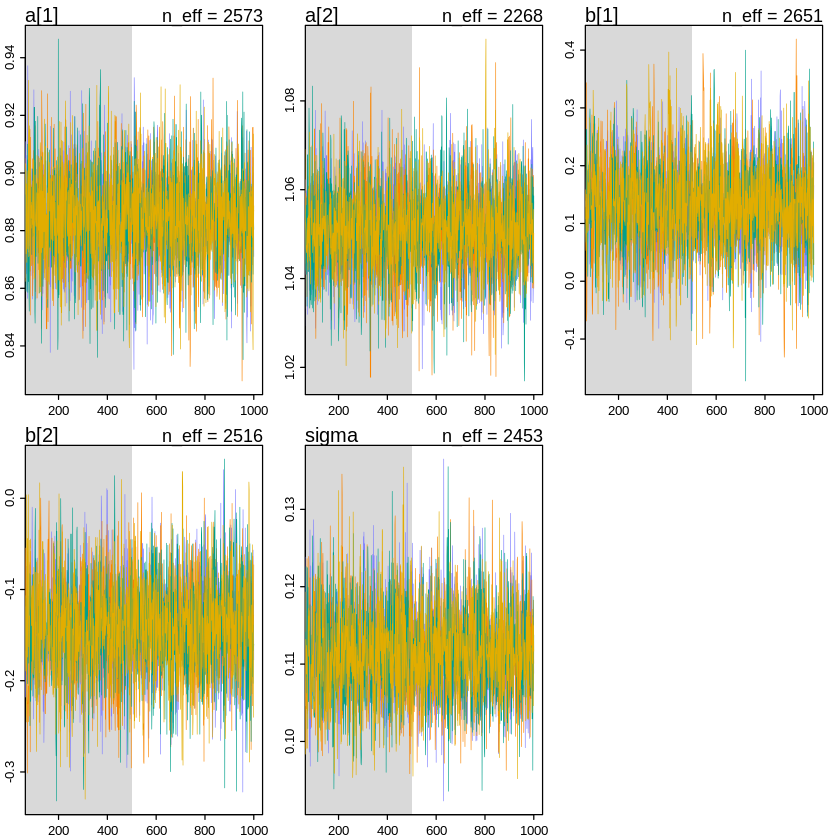

In [85]:
traceplot(m8m1warmup500)

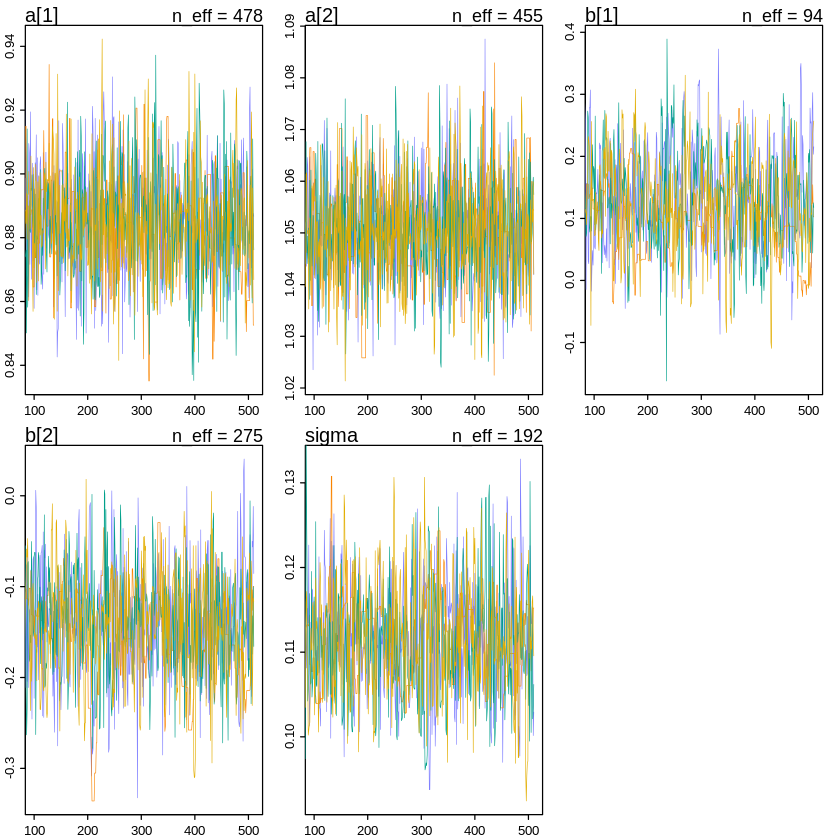

In [86]:
traceplot(m8m1warmup10)

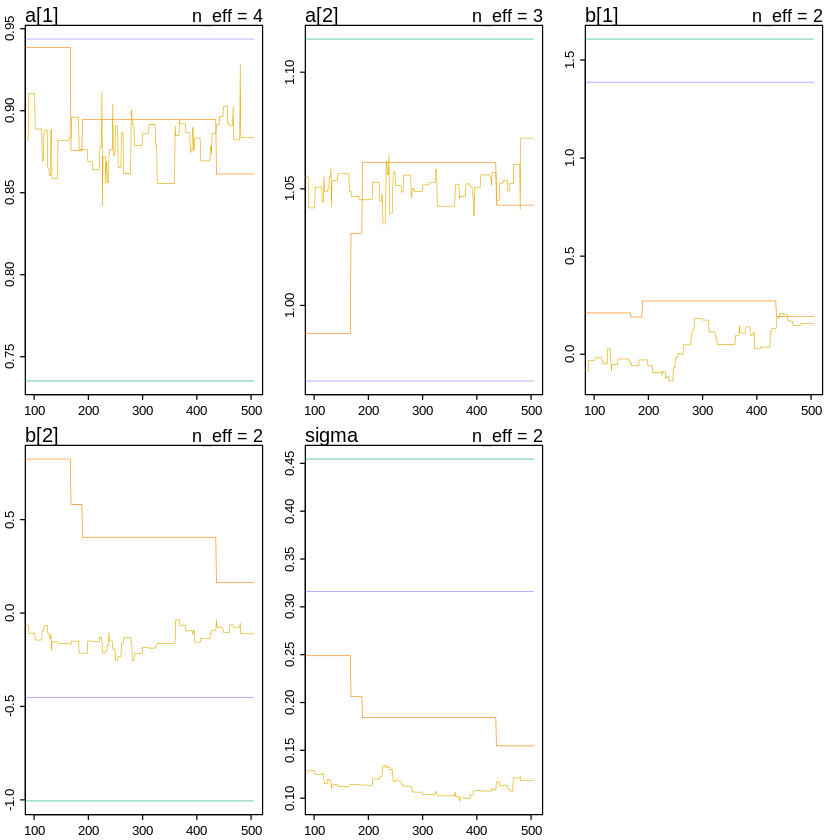

In [87]:
traceplot(m8m1warmup5)

We can clearly see the difference in behaviour for warmup of only 5.

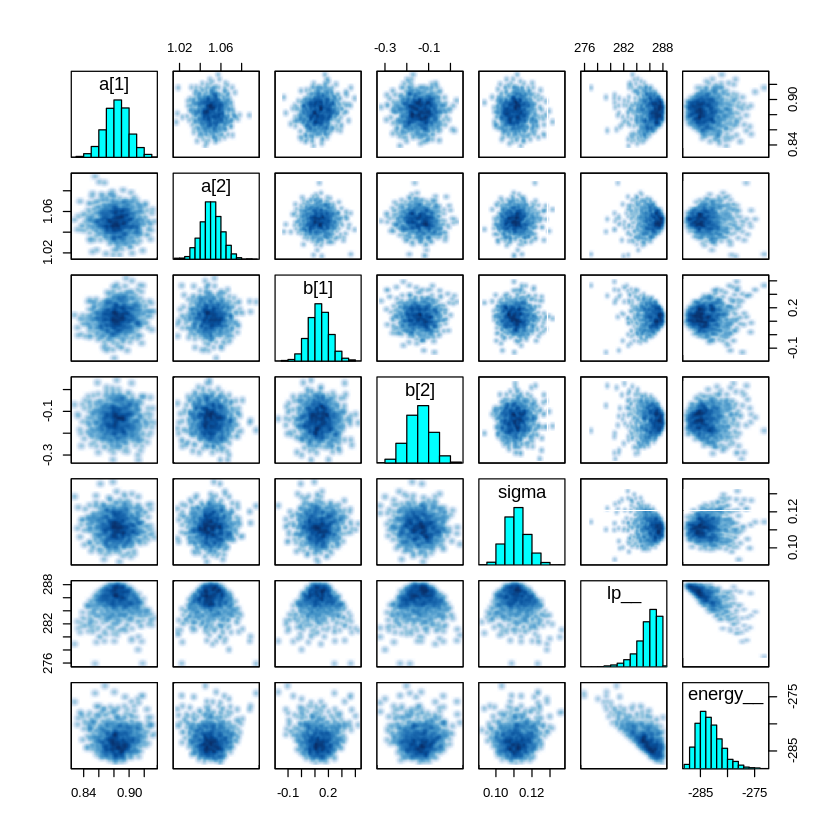

In [88]:
pairs(m8m1warmup500@stanfit)

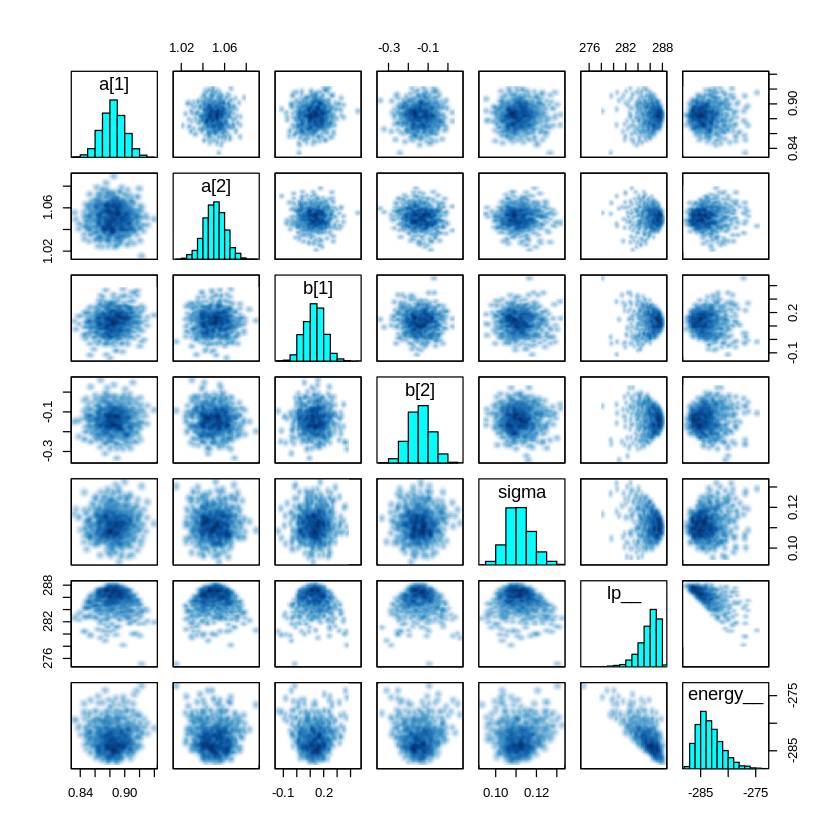

In [89]:
pairs(m8m1warmup50@stanfit)

8H1

In [90]:
mp <- ulam(
alist(
a ~ dnorm(0,1),
b ~ dcauchy(0,1)
),
data=list(y=1),
start=list(a=0,b=0),
iter=1e4, warmup=100,
chains=4, cores=4
, control = list(max_treedepth = 20)
)

Cautionary note:
Variable y contains only integers but is not type 'integer'. If you intend it as an index variable, you should as.integer() it before passing to ulam.


In [91]:
precis(mp)

,mean,sd,5.5%,94.5%,n_eff,Rhat
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
a,-0.004934618,1.006686,-1.617902,1.60131,38285.176,0.999974
b,-0.877129422,43.885058,-6.022893,6.02089,3399.307,1.000732


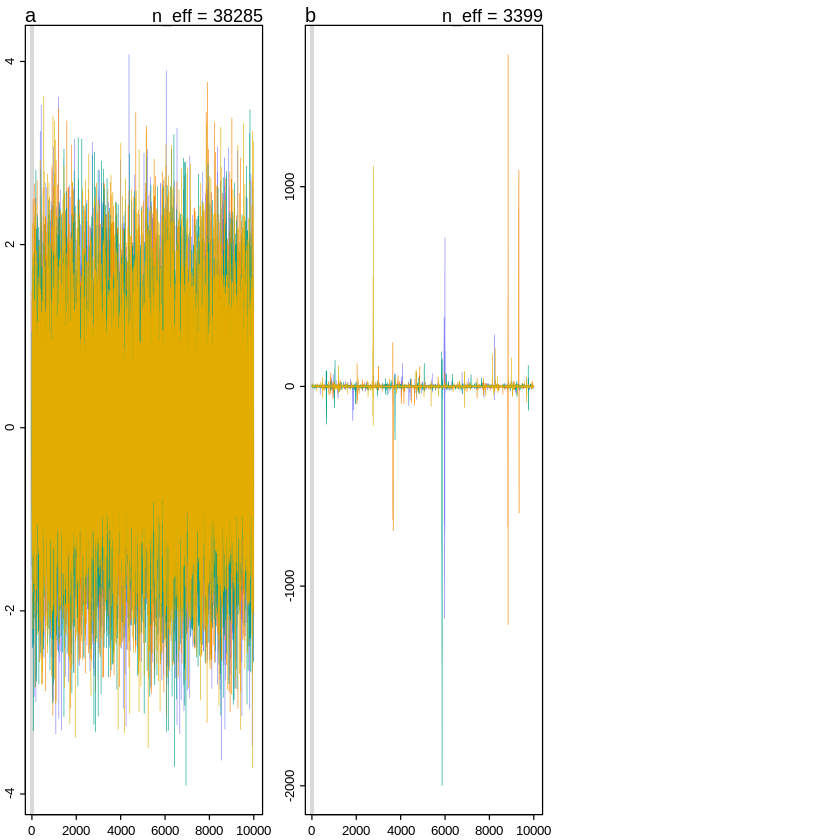

In [92]:
traceplot(mp)

There is no function binding the data output y(=1) to the parameters a and b.  Therefore there is no evidence that the posterior distributions for a and b are any different from their prior.

The Cauchy distribution has higher kurtosis (fatter tails) than the normal distribution. Hence the HMCMC sampler will be able to investigate larger magnitudes of values for b, hence the greater standard deviation of the paramere b, and possibly also the appearence of 'spikes' in the traceplot of b.

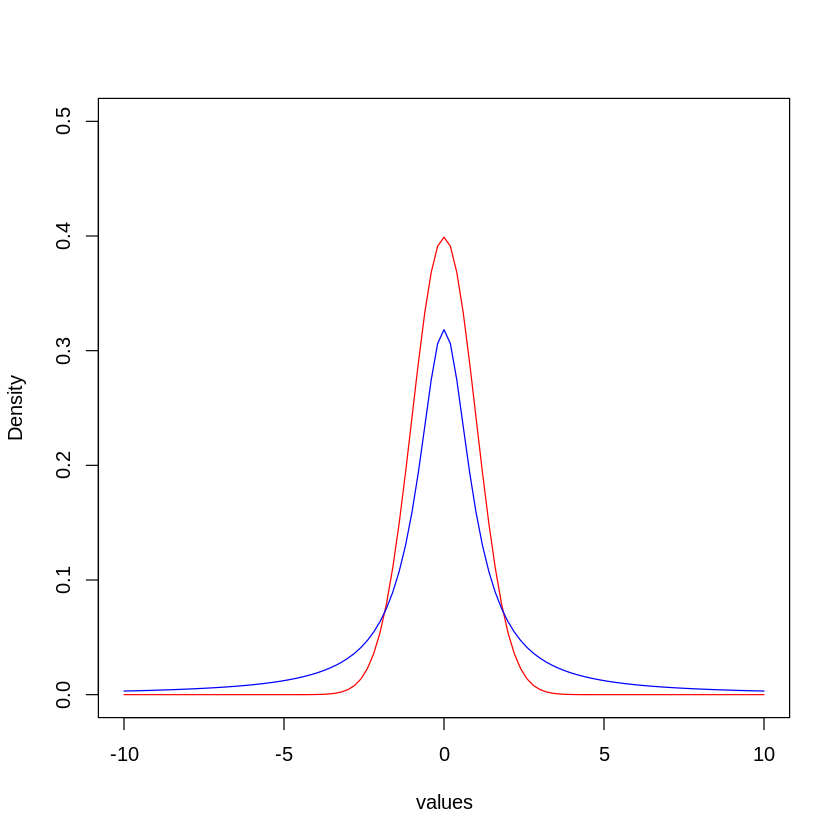

In [93]:
# visualize each prior
curve(dnorm(x, 0, 1), from = -10, to = 10, xlab = "values", ylab = "Density", ylim = c(0, 0.5), col="red")
curve(dcauchy(x, 0, 1), from = -10, to = 10, add = TRUE, col = "blue")

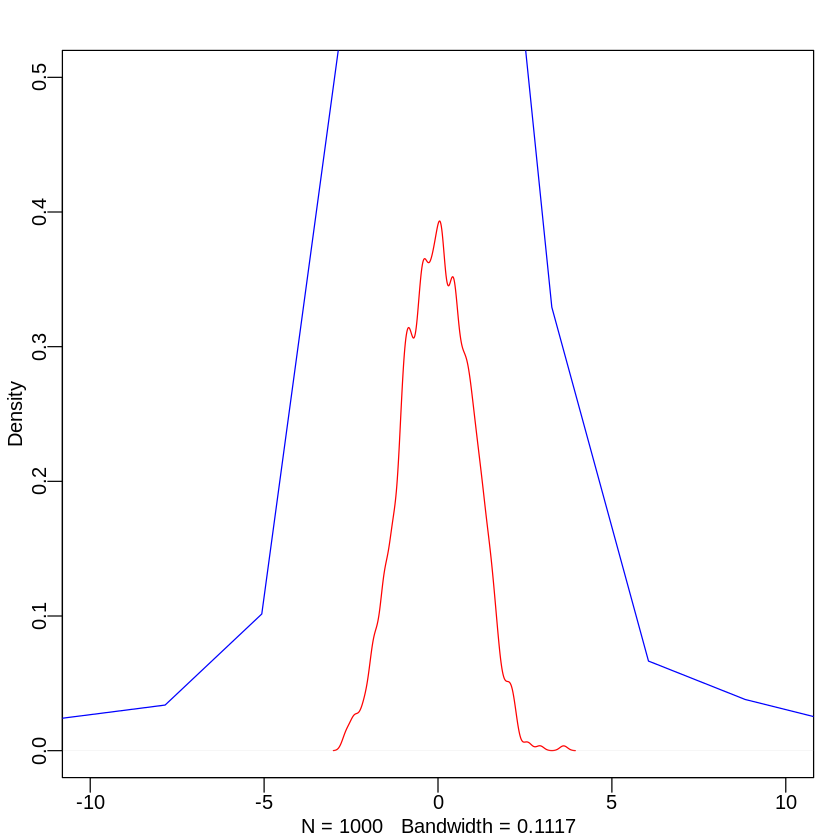

In [94]:
trials <- 1e3

# plot the posterior for parameters a and b
a_samples <- extract.samples(mp,pars="a", n=trials)
b_samples <- extract.samples(mp,pars="b", n=trials)
dens(a_samples[[1]], xlim=c(-10,10), ylim=c(0,0.5), col="red")
dens(b_samples[[1]], add=TRUE, col="blue")


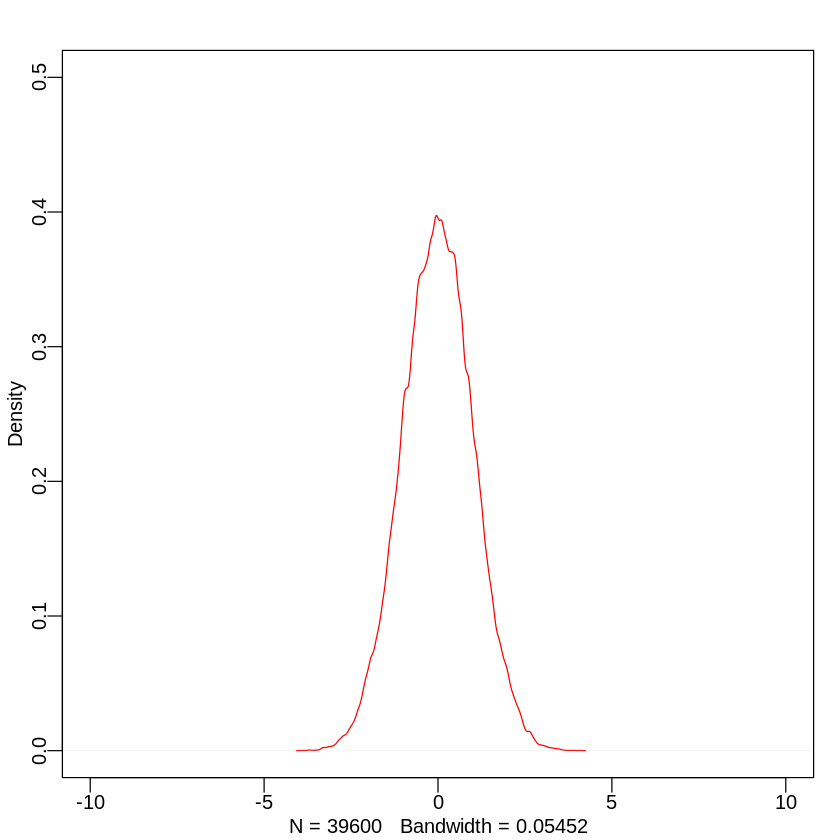

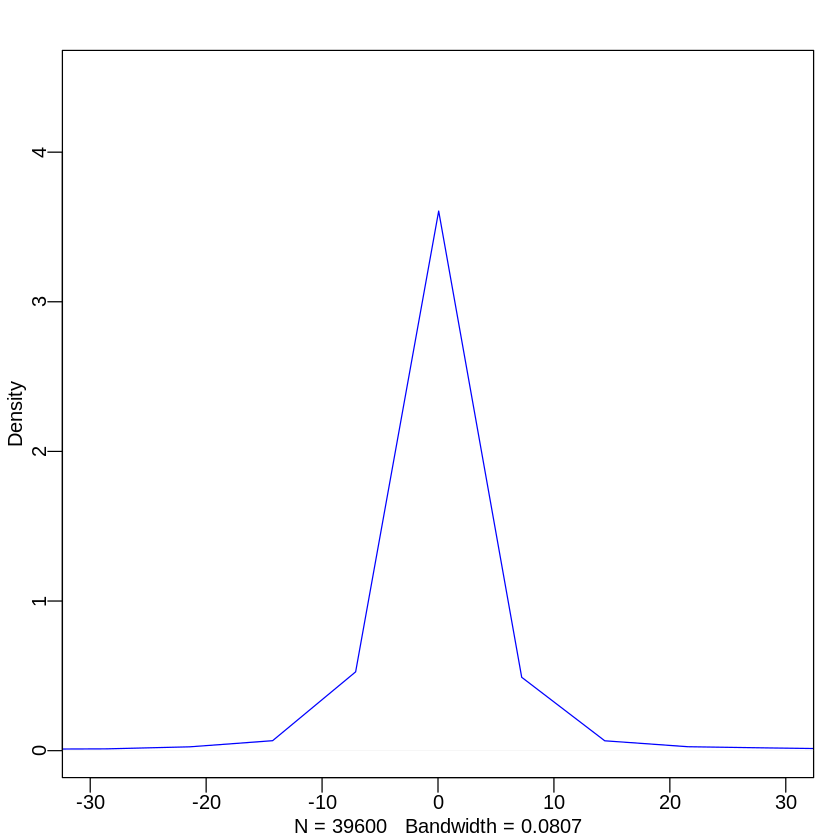

In [95]:
trials <- 1e10

# plot the posterior for parameters a and b
a_samples <- extract.samples(mp,pars="a", n=trials)
b_samples <- extract.samples(mp,pars="b", n=trials)
dens(a_samples[[1]], xlim=c(-10,10), ylim=c(0,0.5), col="red")
dens(b_samples[[1]], xlim=c(-30,30), ylim=c(0,4.5), col="blue")

The parameter a does indeed keep its prior normal distribution. I don't understand the cauchy distributions massive scale here though.

Warning message in KernSmooth::bkde2D(x, bandwidth = bandwidth, gridsize = nbin, :
“Binning grid too coarse for current (small) bandwidth: consider increasing 'gridsize'”Warning message in KernSmooth::bkde2D(x, bandwidth = bandwidth, gridsize = nbin, :
“Binning grid too coarse for current (small) bandwidth: consider increasing 'gridsize'”Warning message in KernSmooth::bkde2D(x, bandwidth = bandwidth, gridsize = nbin, :
“Binning grid too coarse for current (small) bandwidth: consider increasing 'gridsize'”Warning message in KernSmooth::bkde2D(x, bandwidth = bandwidth, gridsize = nbin, :
“Binning grid too coarse for current (small) bandwidth: consider increasing 'gridsize'”Warning message in KernSmooth::bkde2D(x, bandwidth = bandwidth, gridsize = nbin, :
“Binning grid too coarse for current (small) bandwidth: consider increasing 'gridsize'”Warning message in KernSmooth::bkde2D(x, bandwidth = bandwidth, gridsize = nbin, :
“Binning grid too coarse for current (small) bandwidth: consider in

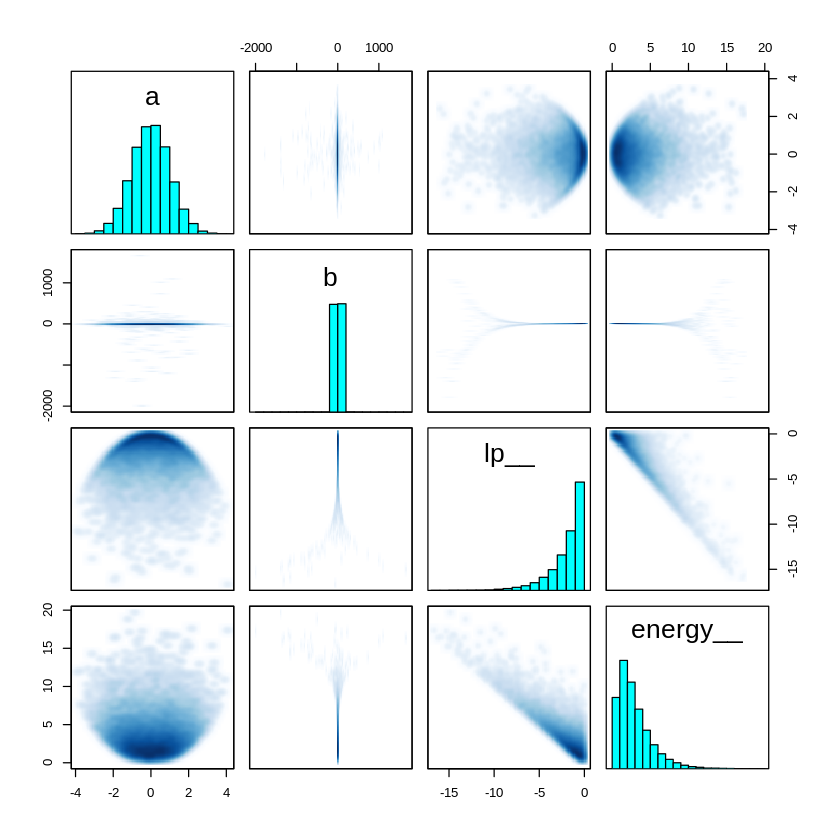

In [96]:
pairs(mp@stanfit)

Warning message in KernSmooth::bkde2D(x, bandwidth = bandwidth, gridsize = nbin, :
“Binning grid too coarse for current (small) bandwidth: consider increasing 'gridsize'”

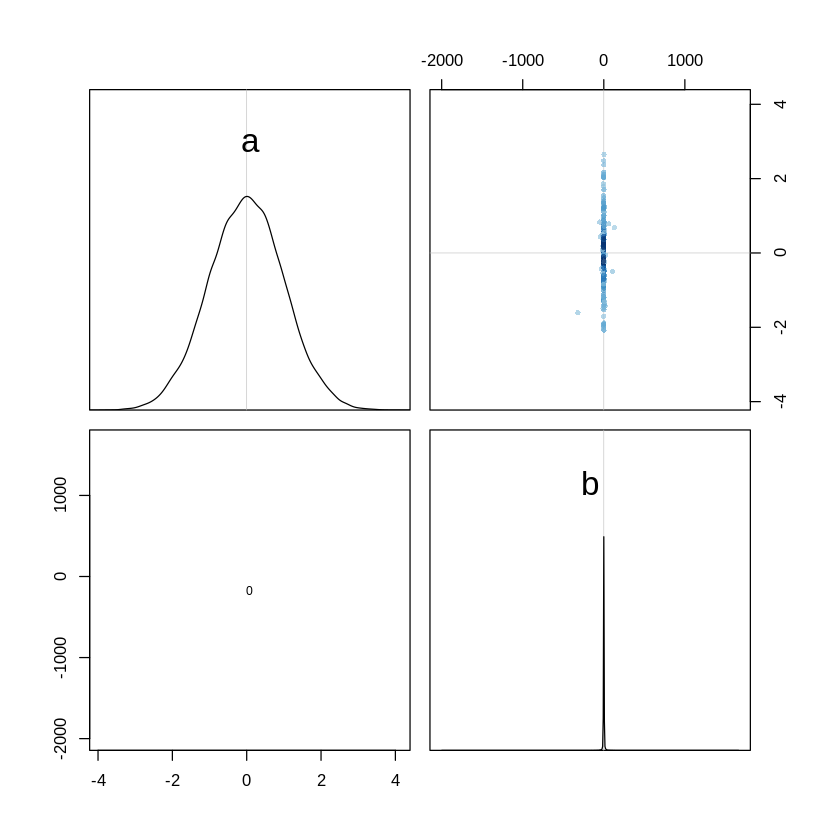

In [97]:
pairs(mp)

From https://socialsciences.mcmaster.ca/jfox/.Materials/Ch-8.html:

"This “model” just draws pairs of values from the standard-normal distribution and the Cauchy distribution with location 0 and scale 1. The two sets of values are drawn independently. The Cauchy distribution has very heavy tails and thus is prone to producing extreme outliers, as is apparent in both the trace plot and the pairs plot."

8H2



In [98]:
# load data and copy
library(rethinking)
data(WaffleDivorce)
d <- WaffleDivorce

# standardize variables
d$A <- as.numeric(scale( d$MedianAgeMarriage ))
d$D <- as.numeric(scale( d$Divorce ))
d$M <- as.numeric(scale( d$Marriage ))

In [99]:
m5.1 <- quap(
alist(
D ~ dnorm( mu , sigma ) ,
mu <- a + bA * A ,
a ~ dnorm( 0 , 0.2 ) ,
bA ~ dnorm( 0 , 0.5 ) ,
sigma ~ dexp( 1 )
) , data = d )

m5.2 <- quap(
alist(
D ~ dnorm( mu , sigma ) ,
mu <- a + bM * M ,
a ~ dnorm( 0 , 0.2 ) ,
bM ~ dnorm( 0 , 0.5 ) ,
sigma ~ dexp( 1 )
) , data = d )

m5.3 <- quap(
alist(
D ~ dnorm( mu , sigma ) ,
mu <- a + bM*M + bA*A ,
a ~ dnorm( 0 , 0.2 ) ,
bM ~ dnorm( 0 , 0.5 ) ,
bA ~ dnorm( 0 , 0.5 ) ,
sigma ~ dexp( 1 )
) , data = d )

precis(m5.1)
precis(m5.2)
precis( m5.3 )

,mean,sd,5.5%,94.5%
,<dbl>,<dbl>,<dbl>,<dbl>
a,3.651938e-08,0.09737873,-0.1556300,0.1556301
bA,-5.684035e-01,0.10999975,-0.7442043,-0.3926026
sigma,7.883253e-01,0.07801123,0.6636483,0.9130023


,mean,sd,5.5%,94.5%
,<dbl>,<dbl>,<dbl>,<dbl>
a,-3.625286e-06,0.10824611,-0.1730018,0.1729946
bM,3.500486e-01,0.12592699,0.1487930,0.5513043
sigma,9.102616e-01,0.08986149,0.7666456,1.0538777


,mean,sd,5.5%,94.5%
,<dbl>,<dbl>,<dbl>,<dbl>
a,-2.730533e-07,0.09707608,-0.1551466,0.1551461
bM,-6.538060e-02,0.15077315,-0.3063452,0.1755840
bA,-6.135141e-01,0.15098368,-0.8548152,-0.3722130
sigma,7.851185e-01,0.07784353,0.6607095,0.9095275


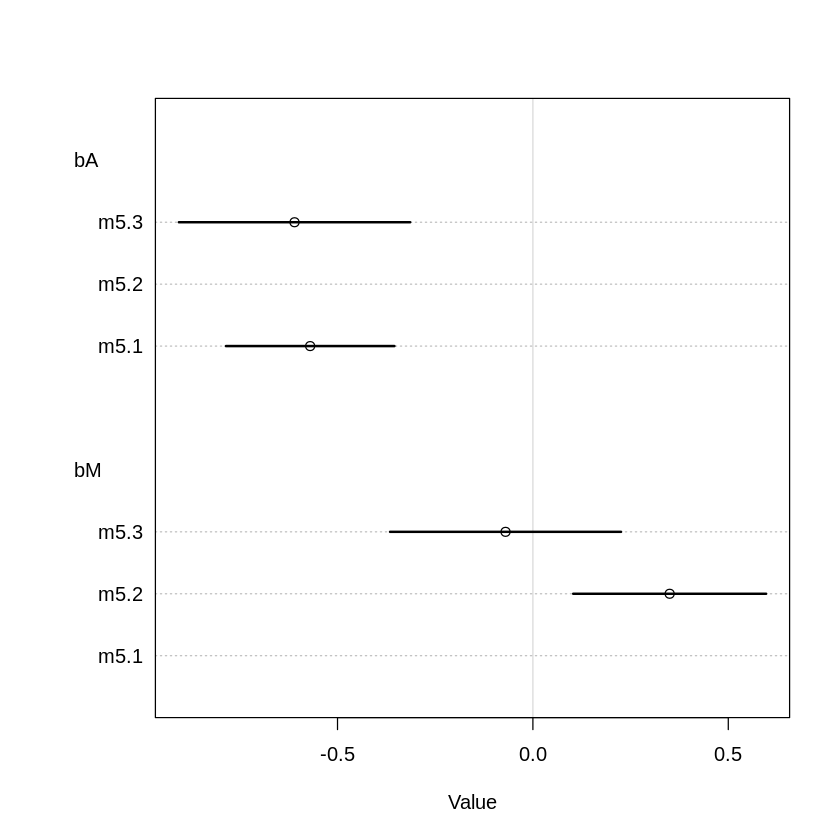

In [100]:
plot( coeftab(m5.1,m5.2,m5.3), par=c("bA","bM") )

In [101]:
compare(m5.1, m5.2, m5.3)

,WAIC,pWAIC,dWAIC,weight,SE,dSE
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
m5.1,126.7816,4.325116,0.000000,0.7411909555,14.28376,NA
m5.3,128.8930,5.669993,2.111404,0.2578959486,14.46402,1.038126
m5.2,140.1799,3.545483,13.398345,0.0009130959,10.86855,10.542669


In [102]:
d.trim <- d[ , c("D","A","M") ]
dd.trim <- d.trim[ complete.cases(d.trim) , ]
head(dd.trim)

dat_slim <- list(
D = dd.trim$D,
A = dd.trim$A,
M = dd.trim$M
)
str(dat_slim)

D,A,M
<dbl>,<dbl>,<dbl>
1.6542053,-0.6062895,0.02264406
1.5443643,-0.6866993,1.54980162
0.6107159,-0.2042408,0.04897436
2.0935693,-1.4103870,1.65512283
-0.9270579,0.5998567,-0.26698927
1.0500799,-0.2846505,0.89154405


List of 3
 $ D: num [1:50] 1.654 1.544 0.611 2.094 -0.927 ...
 $ A: num [1:50] -0.606 -0.687 -0.204 -1.41 0.6 ...
 $ M: num [1:50] 0.0226 1.5498 0.049 1.6551 -0.267 ...


In [103]:
# Note - need to set log_lik = TRUE in order to get WAIC to work in compare() call

m5.1ulam <- ulam(
                alist(
                    D ~ dnorm( mu , sigma ) ,
                    mu <- a + bA * A ,
                    a ~ dnorm( 0 , 0.2 ) ,
                    bA ~ dnorm( 0 , 0.5 ) ,
                    sigma ~ dexp( 1 )
                    ), 
                #data = dd.trim
                data = dat_slim
                , chains=4, cores=4
#                , iter=1000, warmup=500  
                , log_lik=TRUE
            )

m5.2ulam <- ulam(
                alist(
                    D ~ dnorm( mu , sigma ) ,
                    mu <- a + bM * M ,
                    a ~ dnorm( 0 , 0.2 ) ,
                    bM ~ dnorm( 0 , 0.5 ) ,
                    sigma ~ dexp( 1 )
                ) 
                #    , data = dd.trim )
                , data = dat_slim
                , log_lik=TRUE
                , chains=4, cores=4)

m5.3ulam <- ulam(
                alist(
                    D ~ dnorm( mu , sigma ) ,
                    mu <- a + bM*M + bA*A ,
                    a ~ dnorm( 0 , 0.2 ) ,
                    bM ~ dnorm( 0 , 0.5 ) ,
                    bA ~ dnorm( 0 , 0.5 ) ,
                    sigma ~ dexp( 1 )
                )
                #, data = dd.trim )
                , data = dat_slim
                , log_lik=TRUE
                , chains=4, cores=4)

precis( m5.1ulam )
precis( m5.2ulam )
precis( m5.3ulam )

,mean,sd,5.5%,94.5%,n_eff,Rhat
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
a,-0.0003582348,0.10392056,-0.1647384,0.1665168,1823.609,1.0017545
bA,-0.5686154142,0.11543212,-0.7500191,-0.3770132,1771.973,0.9985616
sigma,0.8254832185,0.08622275,0.7006008,0.9641868,1805.883,1.0000608


,mean,sd,5.5%,94.5%,n_eff,Rhat
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
a,-5.971462e-05,0.11129877,-0.1821219,0.1788836,1993.393,1.000511
bM,3.517245e-01,0.13233091,0.1469345,0.5684706,1583.990,1.000306
sigma,9.485325e-01,0.09933568,0.8018085,1.1149836,2230.435,1.000389


,mean,sd,5.5%,94.5%,n_eff,Rhat
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
a,0.0004130756,0.10154990,-0.1624588,0.1595768,1613.7839,1.0007507
bM,-0.0622472480,0.15633417,-0.3123176,0.1911751,976.8982,1.0026292
bA,-0.6072588420,0.15642313,-0.8571346,-0.3512501,1059.0479,1.0013370
sigma,0.8287197942,0.08635035,0.7002742,0.9775040,1381.1506,0.9994249


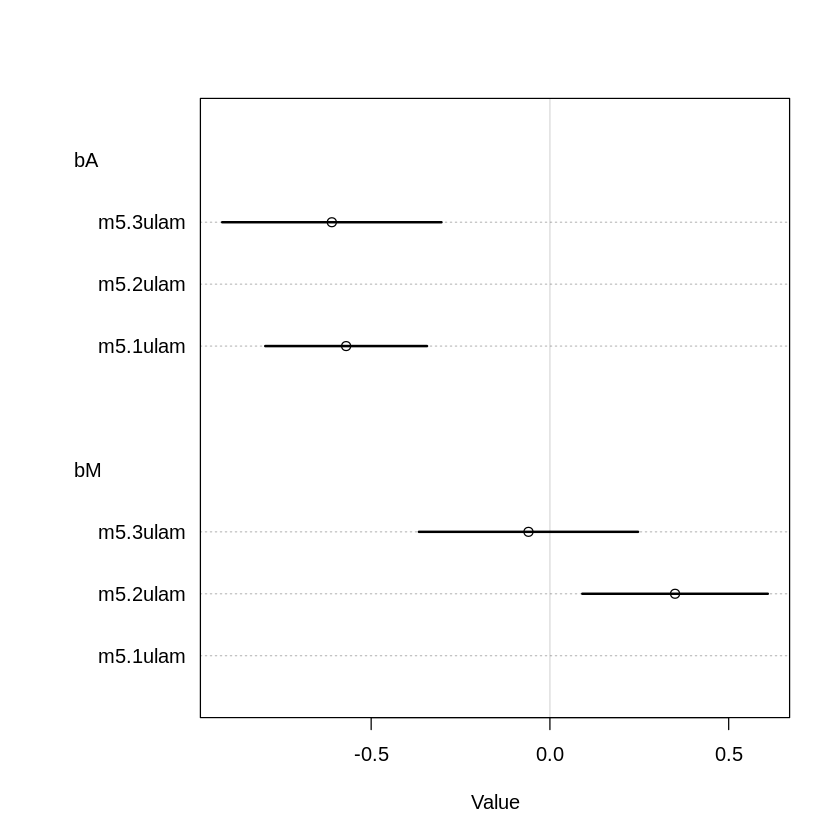

In [104]:
plot( coeftab(m5.1ulam,m5.2ulam,m5.3ulam), par=c("bA","bM") )

In [105]:
# Note - need to set log_lik = TRUE in ulam() order to get WAIC to work here
compare(m5.1ulam, m5.2ulam, m5.3ulam)

,WAIC,pWAIC,dWAIC,weight,SE,dSE
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
m5.1ulam,126.0095,3.769437,0.000000,0.6585856807,12.714484,NA
m5.3ulam,127.3283,4.595366,1.318843,0.3405879361,12.570050,0.7854443
m5.2ulam,139.3711,2.986060,13.361583,0.0008263832,9.835476,9.3513320


In [106]:
compare(m5.1, m5.2, m5.3)

,WAIC,pWAIC,dWAIC,weight,SE,dSE
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
m5.1,126.8004,4.325560,0.000000,0.6743774199,14.21712,NA
m5.3,128.2620,5.323296,1.461671,0.3247170736,14.54752,0.8286178
m5.2,140.0265,3.432273,13.226101,0.0009055065,10.80677,10.4508130


Both quap and ulam models have similar WAICs.  Model 5.1 with just marriage age as predictor works the best, with the mean age of marriage carrying most of the information.  That's why adding marriage rates increases overfitting and leads to worse predictive performance, and that the coefficient for marriage rate cannot be distinguished from 0 when controlling for marriage age.

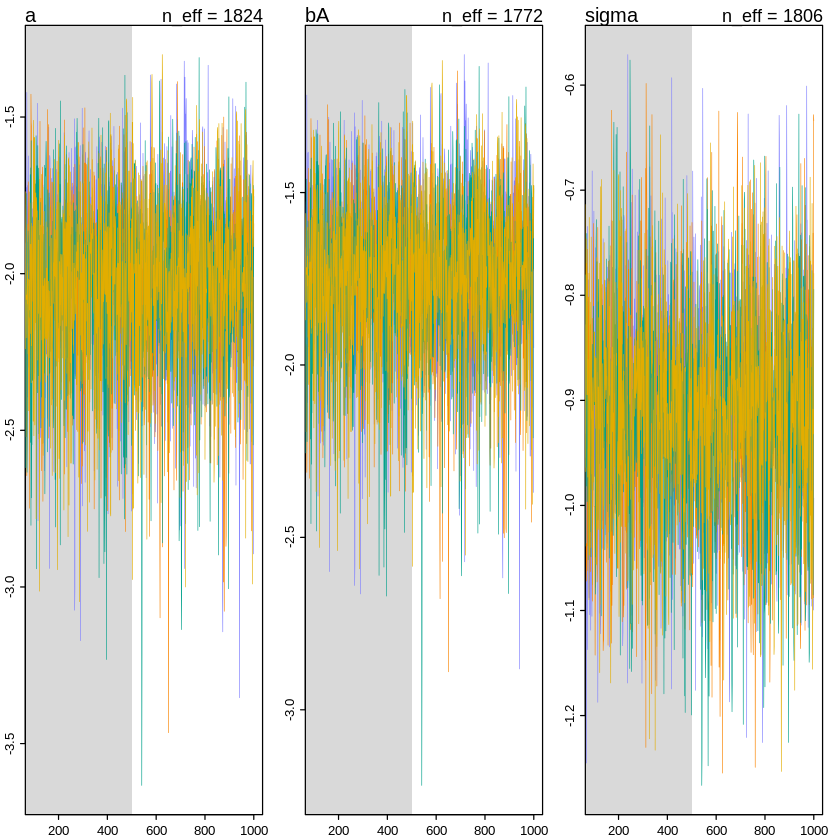

In [107]:
traceplot(m5.1ulam)

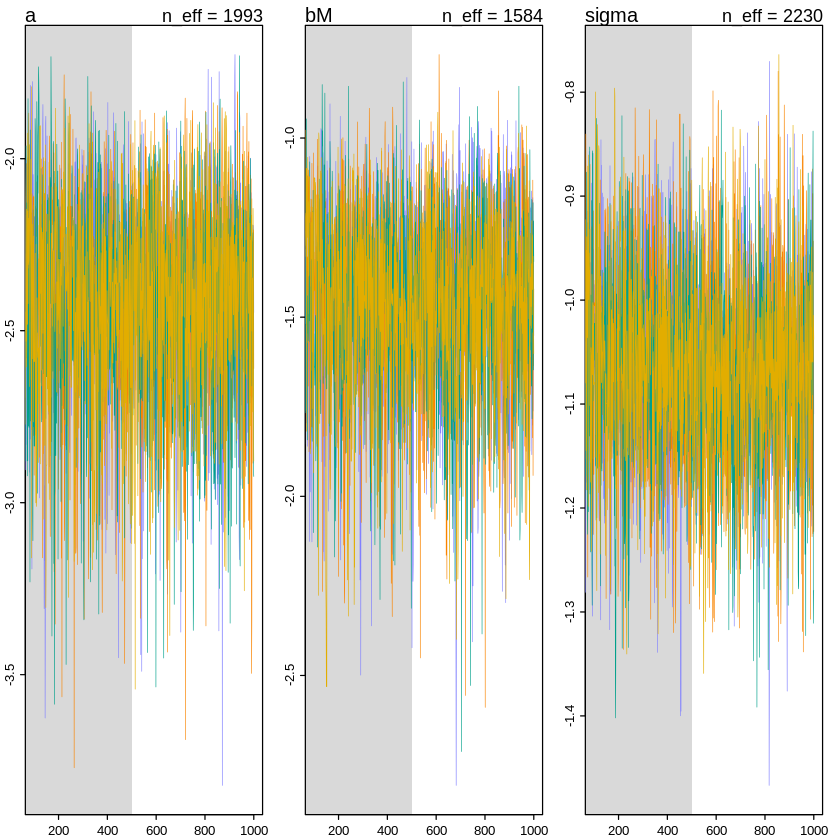

In [108]:
traceplot(m5.2ulam)

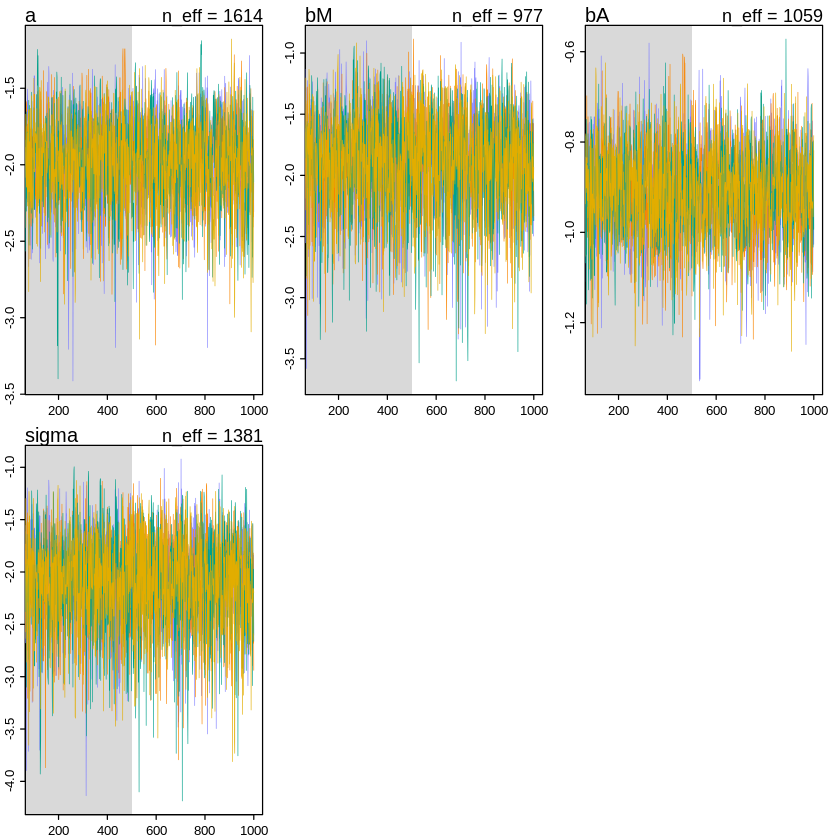

In [109]:
traceplot(m5.3ulam)

8H3

In [9]:
N <- 100
height <- rnorm(N,10,2)
leg_prop <- runif(N,0.4,0.5)
leg_left <- leg_prop*height + rnorm( N , 0 , 0.02 )
leg_right <- leg_prop*height + rnorm( N , 0 , 0.02 )

# sim right leg as proportion + error
# combine into data frame
d <- data.frame(height,leg_left,leg_right)

In [15]:
m5.8u <- ulam(
            alist(
                height ~ dnorm( mu , sigma ) ,
                mu <- a + bl*leg_left + br*leg_right ,
                a ~ dnorm( 10 , 100 ) ,
                bl ~ dnorm( 2 , 10 ) ,
                br ~ dnorm( 2 , 10 ) ,
                sigma ~ dcauchy( 0 , 1 )
            ) ,
            data=d, chains=4, cores=4
#            , start=list(a=10,bl=0,br=0,sigma=1)
            , control=list(max_treedepth=15, adapt_delta = 0.99)
            , log_lik=TRUE
            )

In [16]:
precis(m5.8u)

,mean,sd,5.5%,94.5%,n_eff,Rhat
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
a,1.118303,0.30184411,0.6207700,1.5805318,1000.5058,1.004687
bl,-3.080421,2.30994803,-6.7865574,0.5921980,578.8811,1.007711
br,5.039831,2.30390722,1.3894107,8.7609676,578.7371,1.007504
sigma,0.617039,0.04299669,0.5524996,0.6899161,981.9967,1.003250


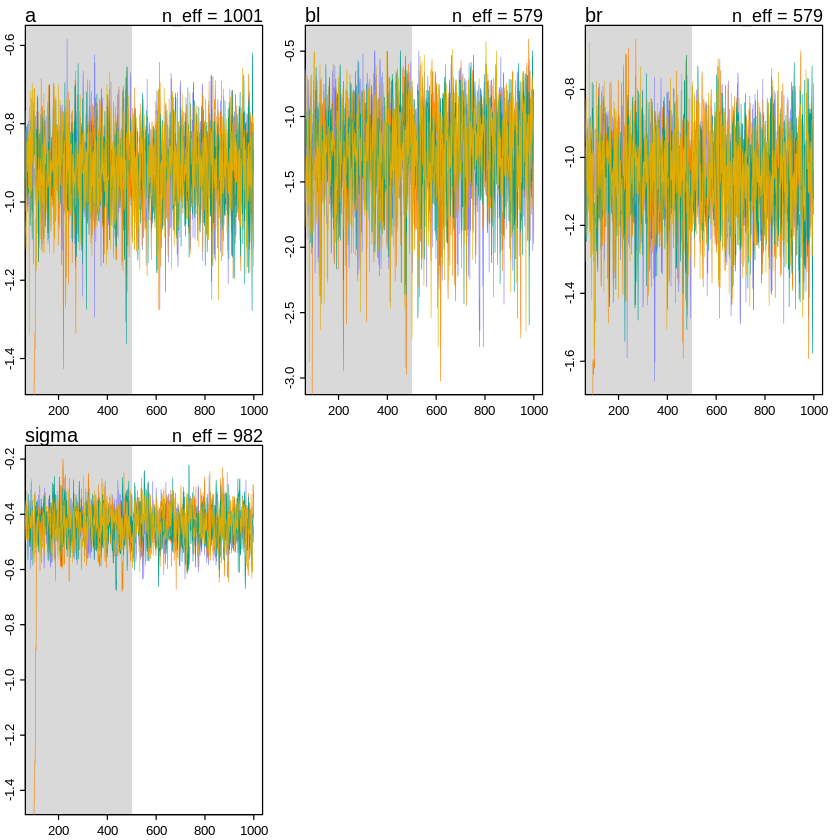

In [17]:
traceplot(m5.8u)

In [19]:
pairs(m5.8u@stanfit)

ERROR: Error in plot.new(): figure margins too large


In [20]:
m5.8u2 <- ulam(
            alist(
                height ~ dnorm( mu , sigma ) ,
                mu <- a + bl*leg_left + br*leg_right ,
                a ~ dnorm( 10 , 100 ) ,
                bl ~ dnorm( 2 , 10 ) ,
                br ~ dhalfnorm( 2 , 10 ) ,      #ulam() cannot handle '&' here, so need to use half_normal or custom contraint (see https://github.com/rmcelreath/rethinking/issues/183)
                sigma ~ dcauchy( 0 , 1 )
            ) ,
            data=d, chains=4, cores=4
#           , start=list(a=10,bl=0,br=0,sigma=1) 
            , control=list(max_treedepth=15, adapt_delta = 0.99)
            , log_lik=TRUE
            )

In [23]:
precis(m5.8u2)

,mean,sd,5.5%,94.5%,n_eff,Rhat
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
a,1.1043447,0.29311286,0.6430707,1.5632038,883.0926,1.003520
bl,-3.2358721,2.16894954,-6.9120606,0.1452406,601.7978,1.003428
br,5.1978030,2.16338128,1.8461705,8.8569965,604.5141,1.003429
sigma,0.6159339,0.04540586,0.5510848,0.6929006,930.6676,1.002506


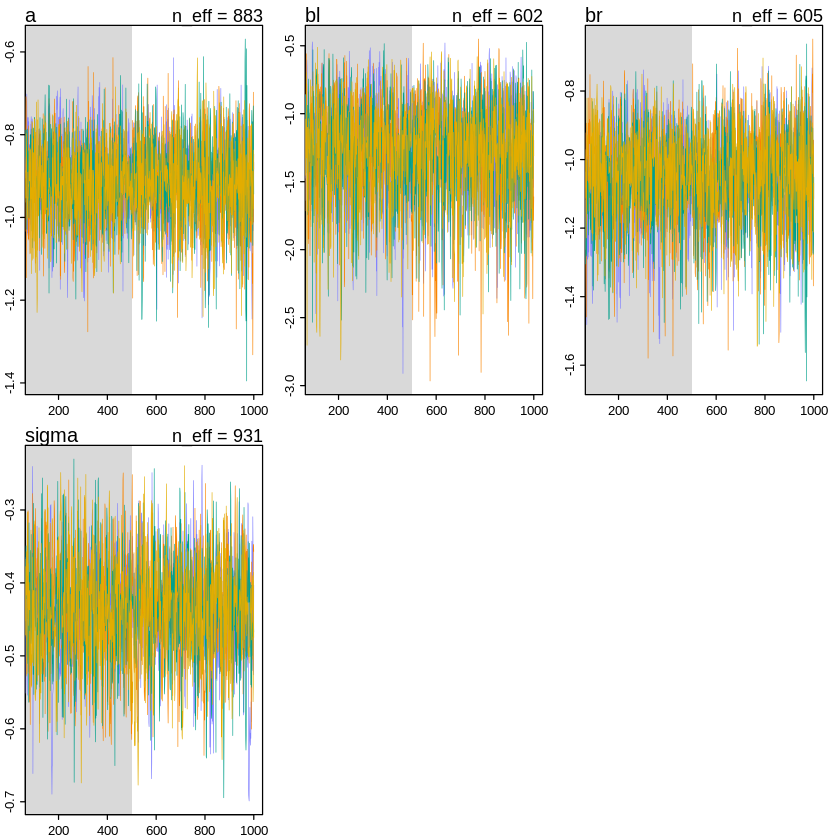

In [27]:
traceplot(m5.8u2)

In [28]:
pairs(m5.8u2@stanfit)

ERROR: Error in plot.new(): figure margins too large


In [21]:
m5.8s2 <- map2stan(
            alist(
                height ~ dnorm( mu , sigma ) ,
                mu <- a + bl*leg_left + br*leg_right ,
                a ~ dnorm( 10 , 100 ) ,
                bl ~ dnorm( 2 , 10 ) ,
                br ~ dnorm( 2 , 10 ) & T[0,] ,      #ulam() cannot handle '&' here, so need to use map2stan.
                sigma ~ dcauchy( 0 , 1 )
            ) ,
            data=d, chains=4, cores=4
           , start=list(a=10,bl=0,br=0,sigma=1) 
            , control=list(max_treedepth=20, adapt_delta = 0.999)
            )

Warning message:
“There were 180 divergent transitions after warmup. Increasing adapt_delta above 0.999 may help. See
http://mc-stan.org/misc/warnings.html#divergent-transitions-after-warmup”Warning message:
“Examine the pairs() plot to diagnose sampling problems
”Computing WAIC
Warning message in map2stan(alist(height ~ dnorm(mu, sigma), mu <- a + bl * leg_left + :
“There were 180 divergent iterations during sampling.
Check the chains (trace plots, n_eff, Rhat) carefully to ensure they are valid.”

In [22]:
precis(m5.8s2)

,mean,sd,5.5%,94.5%,n_eff,Rhat
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
a,1.1305348,0.30779126,0.6377200,1.6207884,1715.777,1.001177
bl,-3.1616864,2.21572285,-6.7071348,0.4243297,1101.232,1.001942
br,5.1190348,2.21416990,1.5214435,8.6650967,1101.207,1.001974
sigma,0.6161668,0.04510103,0.5470825,0.6895877,1703.182,1.002541


Predictably, because we constrain br to be positive, the distribution of br has a mean that is more positive than that of m5.8u.  Because bl and br are highly correlated (due to colinearity of leg_left and leg_right predictors, and as observed in pairs plots), the individual joint samples of bl and br must (still) add up to (approx) 2 (the simulation parameter).  Because of this summation constraint, by forcing br to be positive and shifting its distribution to the right, this shifts the distribution of bl to the left nad makes the mean (and quantiles) of bl more negative.

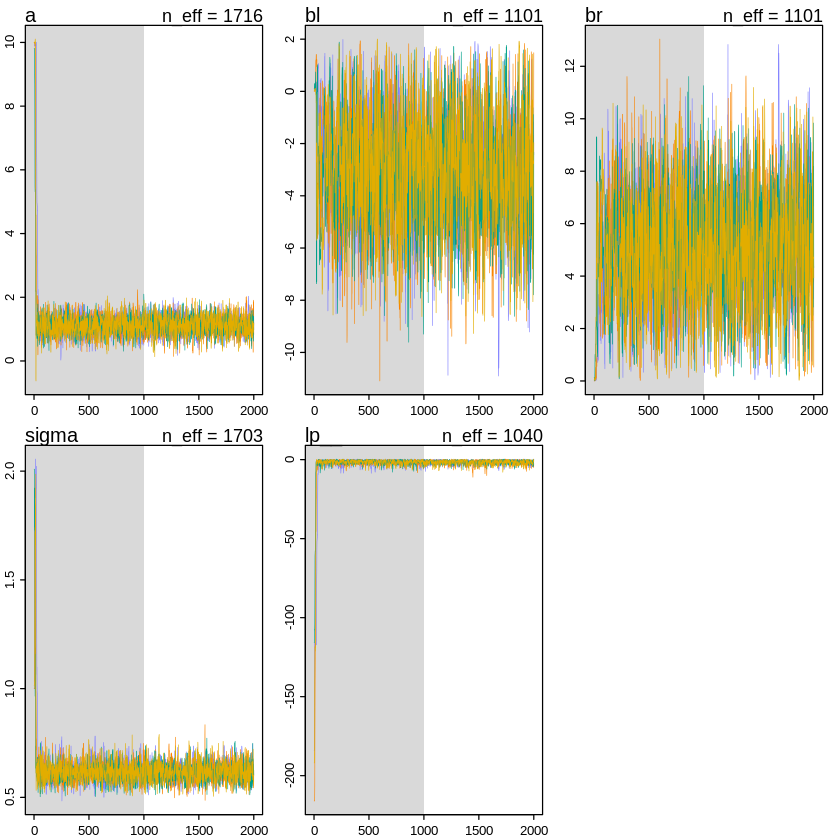

In [24]:
plot(m5.8s2)

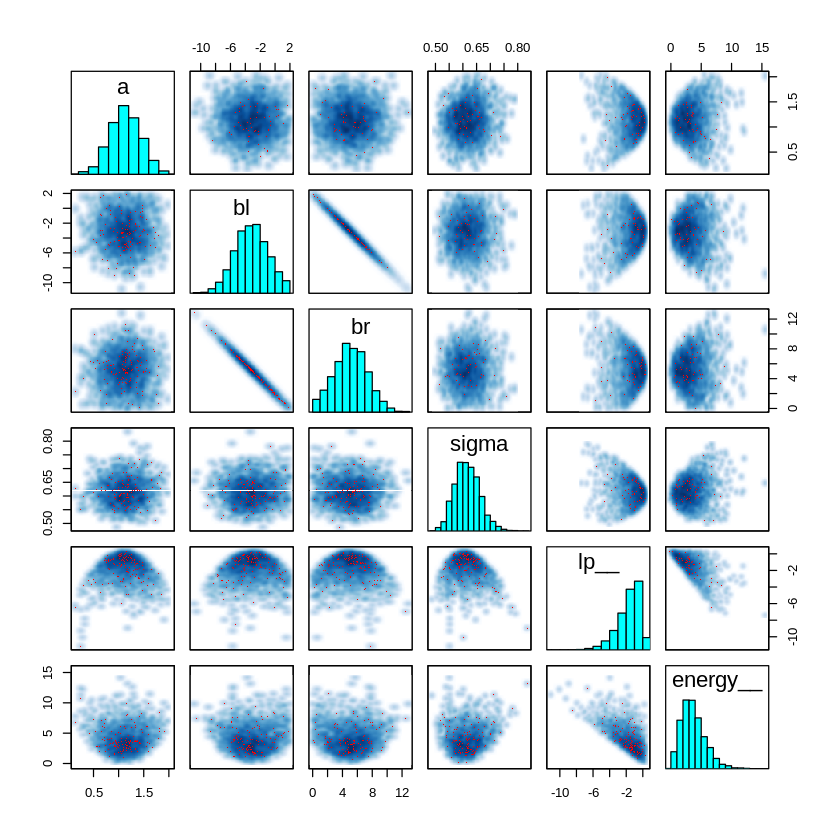

In [25]:
pairs(m5.8s2@stanfit)

Note the shape of the distribution of bl in the pairs plot - the shape (though not the values) is a mirror image of br.  Compare to model m5.8u, where both bl and br are normal distributions.   There is an indication of a convergence problem for the chains for model m5.8s2, where there are occassionally unusual parameter values sampled.

8H4 In order to use compare(), need to run first model using map2stan instead of ulam, which cannot be used in the second model due to the '&' truncation of br.

In [29]:
m5.8s <- map2stan(
            alist(
                height ~ dnorm( mu , sigma ) ,
                mu <- a + bl*leg_left + br*leg_right ,
                a ~ dnorm( 10 , 100 ) ,
                bl ~ dnorm( 2 , 10 ) ,
                br ~ dnorm( 2 , 10 ) ,
                sigma ~ dcauchy( 0 , 1 )
            ) ,
            data=d, chains=4, cores=4
            , start=list(a=10,bl=0,br=0,sigma=1)
            , control=list(max_treedepth=20)
            )

Computing WAIC


In [30]:
compare(m5.8s, m5.8s2)

,WAIC,pWAIC,dWAIC,weight,SE,dSE
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
m5.8s,190.1125,3.809150,0.00000000,0.5115627,11.78209,NA
m5.8s2,190.2050,3.887676,0.09251774,0.4884373,11.83031,0.2456334


In [31]:
compare(m5.8u, m5.8u2)

,WAIC,pWAIC,dWAIC,weight,SE,dSE
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
m5.8u,190.1490,3.866998,0.00000000,0.5015779,11.80141,NA
m5.8u2,190.1617,3.877636,0.01262292,0.4984221,11.84271,0.2161875


Model m5.8s has a higher effective parameters pWAIC value.  This makes sense, as it contains the unconstrained distribution of br.  If we constrain the possible values of one of the parameters, as in m5.8s2, it makes sense that the effective parameters should somehow be reduced, given that the model becomes a little less flexible (fewer degrees of freedom).

The unconstrained model m5.8s has slightly better predictive ability as assessed by WAIC, though this is likely to be due to the higher number of effective parameters (degrees of freedom), hence is potentially a sign of overfitting.


From https://github.com/jffist/statistical-rethinking-solutions/blob/master/ch08_hw.R#L9:
"Effective number of parameters for the second model is smaller. 
Intuitively it is smaller because we restricted "freedom" of the 'br' coefficient. This parameter couldn't be negative for the second model, while the probability of having big values is still very small as for the first model. Thus overall freedom of the model declined.
More formally, pWAIC is defined as sum of variance of the points likelihood, thus the second model has smaller variance of data likelihood(==> it's 'more restricted')"

8H5 Boring

8H6


In [ ]:
p = 0.7  # Probability of water, corresponds to state -1.  Land corresponds to state 1.

num_samples <- 1e5
positions <- rep(0,num_samples)
current <- 1
for ( i in 1:num_samples ) {
# record current position
positions[i] <- current
# flip coin to generate proposal
proposal <- current + sample( c(-2,2) , size=1 )
# now make sure he loops around the archipelago
if ( proposal < -1 ) proposal <- 1
if ( proposal > 1 ) proposal <- -1
# move?
prob_move <- ( p **  current ) * ( ( 1-p ) ** proposal )
current <- ifelse( runif(1) < prob_move , proposal , current )
}

In [ ]:
plot(positions)

In [ ]:
positionsIndicator <- (positions+1)/2
1-mean(positionsIndicator)

This is our estimate of p.